# 1. Installing the necessary libraries

In [ ]:
# Run this cell if you have to install pytorch
#!pip install torch==1.8.1+cu111 torchvision==0.9.1+cu111 torchaudio===0.8.1 -f https://download.pytorch.org/whl/lts/1.8/torch_lts.html

In [ ]:
# getting yolov5 repository
!git clone https://github.com/ultralytics/yolov5
!ls
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 17270, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 17270 (delta 0), reused 0 (delta 0), pack-reused 17265 (from 1)
Receiving objects: 100% (17270/17270), 16.12 MiB | 28.70 MiB/s, done.
Resolving deltas: 100% (11858/11858), done.
sample_data  yolov5
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 72.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 41.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 

In [ ]:
import torch
from matplotlib import pyplot as plt
import numpy as np
import os
from zipfile import ZipFile

## 2.Load Model

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

/usr/local/lib/python3.11/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


YOLOv5 🚀 2025-2-2 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)

100%|██████████| 14.1M/14.1M [00:00<00:00, 185MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 




```
# This is formatted as code
```

##5. Train from scratch

Some instructions regarding this tool:<br>
1. Training directory set kore dite hobe.
2. Label Directory set kore dite hobe.
3. YOLO format set kore dite hobe.
4. Label directory te classes naame ekta folder toiri hobe, be sure to mention your class name there

### Placing the dataset


In [ ]:
!pip install roboflow
%cd yolov5
from roboflow import Roboflow
rf = Roboflow(api_key="EIYLr8taYjmOnw7xykZu")
project = rf.workspace("neural-flow").project("hit-and-run-case")
version = project.version(13)
dataset = version.download("yolov5")


[Errno 2] No such file or directory: 'yolov5'
/content/yolov5
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to hit-and-run-case-13 in yolov5pytorch:: 100%|██████████| 24632/24632 [00:05<00:00, 4609.61it/s]


In [ ]:
# prompt: check number of file in a folder

import os
def count_files(directory):
  """Counts the number of files in a given directory.

  Args:
    directory: The path to the directory.

  Returns:
    The number of files in the directory.
  """
  return len([name for name in os.listdir(directory) if os.path.isfile(os.path.join(directory, name))])

# Example usage
train = count_files(f"{dataset.location}/train/images")  # Replace with the actual directory path
print(f"Train: {train}")
val = count_files(f"{dataset.location}/valid/images")  # Replace with the actual directory path
print(f"Val: {val}")
test = count_files(f"{dataset.location}/test/images")  # Replace with the actual directory path
print(f"Test: {test}")


Train: 11181
Val: 601
Test: 528


<h4>Preparing the yaml file in the <b>yolov5 folder</b></h4>
Name it something like dataset.yaml

In [ ]:
%cd /content/yolov5/

# Construct the command using f-string
command = f"python train.py --img 640 --epochs 40 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache"

# Execute the command
print("Running:", command)
get_ipython().system(command)  # This runs the shell command in Colab


In [ ]:
%cd /content/yolov5/
command = f"python val.py --weights '/content/yolov5/runs/train/exp/weights/best.pt' --data {dataset.location}/data.yaml --img 640 --half"
# Execute the command
print("Running:", command)
get_ipython().system(command)  # This runs the shell command in Colab

# !python val.py --weights '/content/yolov5/runs/exp/weights/best.pt' --data '/content/yolov5/hit-and-run-case-8/data.yaml' --img 640 --half

/content/yolov5
Running: python val.py --weights '/content/yolov5/runs/train/exp/weights/best.pt' --data /content/yolov5/hit-and-run-case-13/data.yaml --img 640 --half
val: data=/content/yolov5/hit-and-run-case-13/data.yaml, weights=['/content/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v7.0-398-g5cdad892 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/hit-and-run-case-13/valid/labels... 601 images, 0 backgrounds, 0 corrupt: 100% 601/601 [00:00<00:00, 2035.49it/s]
val: New cache created: /content/yolov5/hit-and-run-case-13/valid/labels.cache
                 Class     I

In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/

command = f"python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 640 --conf 0.6 --source {dataset.location}/test/images"
# Execute the command
print("Running:", command)
get_ipython().system(command)  # This runs the shell command in Colab

# !python detect.py --weights runs/train/exp/weights/best.pt --img 610 --conf 0.6 --source /content/hit-and-run-case-8/test/images

/content/yolov5
Running: python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 610 --conf 0.6 --source /content/yolov5/hit-and-run-case-13/test/images
detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=/content/yolov5/hit-and-run-case-13/test/images, data=data/coco128.yaml, imgsz=[610, 610], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-398-g5cdad892 Python-3.11.11 torch-2.5.1+cu124 CUDA:0 (Tesla T4, 15095MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ --img-size [610, 610] must be multiple of max stride 32, updating to [640, 640]
ima

The training data are available at: /content/yolov5/runs/train/exp

#6.Load Your  Model

In [ ]:
model = torch.hub.load('ultralytics/yolov5', 'custom', path='/content/best (1).pt', force_reload=True)

/usr/local/lib/python3.11/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
YOLOv5 🚀 2025-1-31 Python-3.11.11 torch-2.5.1+cu124 CPU

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


In [ ]:
# prompt: random image path

import os
import random
import cv2


def get_random_image_path(directory):
  """
  Returns a random image path from a given directory.

  Args:
    directory: The directory containing the images.

  Returns:
    A random image path, or None if no images are found.
  """
  image_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.gif')  # Add more if needed
  image_files = [f for f in os.listdir(directory) if f.lower().endswith(image_extensions)]
  if image_files:
    random_image = random.choice(image_files)
    return os.path.join(directory, random_image)
  else:
    return None

`torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.


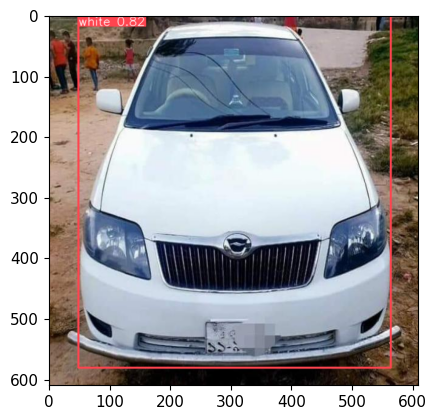

In [ ]:
image_directory = '/content/yolov5/hit-and-run-case-8/train/images'
random_image_path = get_random_image_path(image_directory)
results = model(random_image_path)
%matplotlib inline
plt.imshow(np.squeeze(results.render()))
plt.show()

In [2]:
# prompt: copy from one directory to another

import shutil
import os

def copy_directory(source_dir, destination_dir):
    """Copies a directory and its contents to a new location.

    Args:
        source_dir: The path to the source directory.
        destination_dir: The path to the destination directory.
    """
    try:
        shutil.copytree(source_dir, destination_dir)
        print(f"Successfully copied '{source_dir}' to '{destination_dir}'")
    except FileExistsError:
        print(f"Destination directory '{destination_dir}' already exists. Skipping copy.")
    except FileNotFoundError:
        print(f"Source directory '{source_dir}' not found.")
    except Exception as e:
        print(f"An error occurred: {e}")

# Example usage:
# Replace with your actual source and destination directories.
# source_directory = "/path/to/your/source/directory"
# destination_directory = "/path/to/your/destination/directory"


#copy_directory(source_directory, destination_directory)


In [4]:
source_directory = "/content/drive/MyDrive/Model/v13/train/exp/"
destination_directory = "/content/runs/exp2/"


copy_directory(source_directory, destination_directory)

Successfully copied '/content/drive/MyDrive/Model/v13/train/exp/' to '/content/runs/exp2/'


In [ ]:
shutil.rmtree('/content/yolov5/runs/val/exp')


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import roboflow

rf = roboflow.Roboflow(api_key="EIYLr8taYjmOnw7xykZu")
project = rf.workspace().project("hit-and-run-case")

#can specify weights_filename, default is "weights/best.pt"
version = project.version('13')
version.deploy("yolov5", "/content/drive/MyDrive/Model/Final Version/")




loading Roboflow workspace...
loading Roboflow project...
View the status of your deployment at: https://app.roboflow.com/neural-flow/hit-and-run-case/13
Share your model with the world at: https://universe.roboflow.com/neural-flow/hit-and-run-case/model/13


In [ ]:
shutil.rmtree('/content/yolov5/runs/train/exp/exp')


In [5]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!pip install ultralytics

/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


YOLOv5 <class 'models.common.Detections'> instance
image 1/1: 480x720 1 maroon
Speed: 13.7ms pre-process, 283.5ms inference, 1.2ms NMS per image at shape (1, 3, 448, 640)

In [ ]:
import os
import cv2
import re
from glob import glob
from pathlib import Path

def extract_metadata_from_filename(filename):
    """
    Extracts CCTV ID, latitude, longitude, and timestamp from a structured filename.

    Expected format:
    cctvID_latitude-longitude_yyyy-mm-dd_hh-mm-ss.jpg

    Parameters:
        filename (str): The file name.

    Returns:
        dict: Extracted metadata (CCTV ID, location, and time).
    """
    pattern = r"cctv(\d+)_(\d+\.\d+)-(\d+\.\d+)_(\d{4}-\d{2}-\d{2}_\d{2}-\d{2}-\d{2})"
    match = re.search(pattern, filename)

    if match:
        return {
            "cctv": int(match.group(1)),  # CCTV ID
            "loc": {
                "latitude": float(match.group(2)),   # Latitude
                "longitude": float(match.group(3))  # Longitude
            },
            "time": match.group(4)  # Timestamp
        }
    return {
        "cctv": None,
        "loc": {
            "latitude": None,
            "longitude": None
        },
        "time": None
    }

def process_image_with_yolo(model, image_path, target_color, output_folder):
    """
    Runs YOLOv5 on an image, extracts car color along with metadata from the file name,
    and crops and saves the detected cars of the target color.

    Parameters:
        model: Trained YOLOv5 model.
        image_path: Path to the image file.
        target_color: The car color to filter for.
        output_folder: Path where cropped car images will be saved.

    Returns:
        dict: Extracted car information with metadata.
    """
    try:
        results = model(image_path)  # Run YOLOv5 model
        detected_objects = results.pandas().xyxy[0]  # Convert results to Pandas DataFrame

        file_name = os.path.basename(image_path)  # Extract file name
        metadata = extract_metadata_from_filename(file_name)  # Extract CCTV, location, and time

        # Filter detected objects for the target color
        target_color_objects = detected_objects[detected_objects['name'] == target_color]

        # Crop and save the detected cars matching the target color
        for idx, row in target_color_objects.iterrows():
            x_min, y_min, x_max, y_max = int(row['xmin']), int(row['ymin']), int(row['xmax']), int(row['ymax'])

            # Crop the image based on bounding box coordinates
            img = cv2.imread(image_path)
            cropped_car = img[y_min:y_max, x_min:x_max]

            # Create output folder if not exists
            Path(output_folder).mkdir(parents=True, exist_ok=True)

            # Save the cropped image with a unique name
            output_image_path = os.path.join(output_folder, f"{file_name}_{idx}.jpg")
            cv2.imwrite(output_image_path, cropped_car)

        # Update frameTitle to be output_image_path
        return {
            "carColor": target_color,
            "frameTitle": output_image_path,  # Now this will be the path to the cropped image
            "time": metadata["time"],
            "cctv": metadata["cctv"],
            "loc": metadata["loc"],
            "numberPlateDirected": False,
            "carNumber": None
        }
    except Exception as e:
        print(f"Error processing {image_path}: {e}")
        return None

def process_folder(model, folder_path, target_color, output_folder):
    """
    Processes all images in a folder using YOLOv5 and returns a list of results
    where the detected car color matches the target color, also cropping and saving the cars.

    Parameters:
        model: Trained YOLOv5 model.
        folder_path: Path to the folder containing images.
        target_color: Car color to filter results.
        output_folder: Path to save cropped car images.

    Returns:
        list: Array of detected images where the car color matches the target color.
    """
    folder_path = Path(folder_path)  # Use pathlib for better path handling
    if not folder_path.exists() or not folder_path.is_dir():
        raise ValueError(f"The folder path {folder_path} is invalid or does not exist.")

    image_paths = glob(str(folder_path / "*.jpg"))  # Get all JPG images in folder
    if not image_paths:
        raise ValueError(f"No images found in the folder {folder_path}.")

    filtered_results = []

    for image_path in image_paths:
        result = process_image_with_yolo(model, image_path, target_color, output_folder)  # Process each image
        if result and result["carColor"] == target_color:  # Check if color matches
            filtered_results.append(result)

    return filtered_results

# Example Usage
folder_path = "/content/images"
target_color = "white"  # Filter for white cars
output_folder = "/content/results2"  # Folder to save cropped images

try:
    output = process_folder(model, folder_path, target_color, output_folder)
    print(output)
except ValueError as e:
    print(f"Error: {e}")


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv7_23.8265-90.3044_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv8_23.7887-90.3134_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv2_23.7514-90.4492_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv1_23.7151-90.3911_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv7_23.8715-90.471_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv6_23.7643-90.3946_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv9_23.8627-90.4838_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv10_23.701-90.3934_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv10_23.7265-90.4499_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv9_23.744-90.4607_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv9_23.7775-90.3833_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv2_23.7271-90.3011_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv2_23.8359-90.3947_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv6_23.7235-90.4087_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv3_23.8749-90.3623_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv5_23.7419-90.3649_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv9_23.7328-90.3309_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv10_23.7945-90.3709_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv2_23.847-90.3434_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv10_23.7931-90.3894_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv4_23.7764-90.3533_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv9_23.8398-90.3742_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv10_23.8403-90.3691_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv6_23.8208-90.4091_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv4_23.773-90.3909_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv7_23.851-90.4_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv6_23.8921-90.3002_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv4_23.8709-90.3396_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv6_23.7443-90.4058_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv1_23.8528-90.3829_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv8_23.7159-90.4952_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv3_23.7315-90.4951_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv10_23.7132-90.3633_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv9_23.8268-90.3255_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv3_23.8127-90.4605_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv4_23.7937-90.394_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Error processing /content/images/cctv7_23.7444-90.4781_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:894: FutureWarning: `torch.cuda.am

Error processing /content/images/cctv1_23.8939-90.3414_2025-01-31_10-31-48.jpg: cannot access local variable 'output_image_path' where it is not associated with a value
[{'carColor': 'white', 'frameTitle': '/content/results2/cctv4_23.8589-90.3591_2025-01-31_10-31-48.jpg_0.jpg', 'time': '2025-01-31_10-31-48', 'cctv': 4, 'loc': {'latitude': 23.8589, 'longitude': 90.3591}, 'numberPlateDirected': False, 'carNumber': None}, {'carColor': 'white', 'frameTitle': '/content/results2/cctv7_23.8221-90.3767_2025-01-31_10-31-48.jpg_2.jpg', 'time': '2025-01-31_10-31-48', 'cctv': 7, 'loc': {'latitude': 23.8221, 'longitude': 90.3767}, 'numberPlateDirected': False, 'carNumber': None}, {'carColor': 'white', 'frameTitle': '/content/results2/cctv6_23.8906-90.3068_2025-01-31_10-31-48.jpg_0.jpg', 'time': '2025-01-31_10-31-48', 'cctv': 6, 'loc': {'latitude': 23.8906, 'longitude': 90.3068}, 'numberPlateDirected': False, 'carNumber': None}, {'carColor': 'white', 'frameTitle': '/content/results2/cctv7_23.7192-90

Loading image from: /content/results2/cctv4_23.8589-90.3591_2025-01-31_10-31-48.jpg_0.jpg


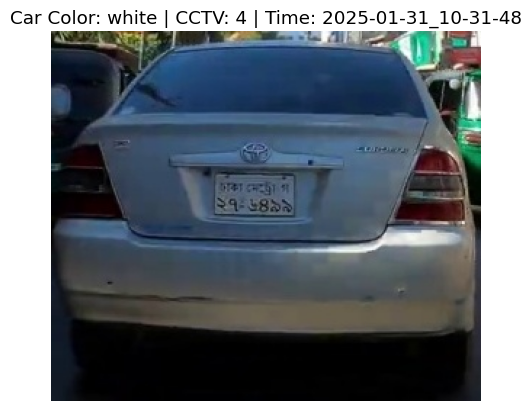

Loading image from: /content/results2/cctv7_23.8221-90.3767_2025-01-31_10-31-48.jpg_2.jpg


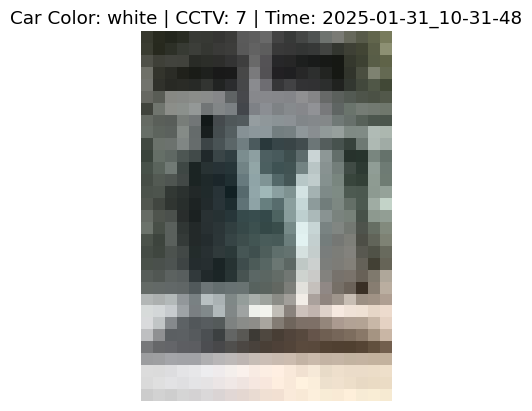

Loading image from: /content/results2/cctv6_23.8906-90.3068_2025-01-31_10-31-48.jpg_0.jpg


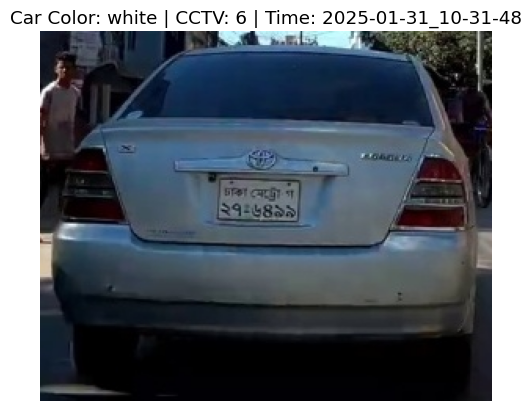

Loading image from: /content/results2/cctv7_23.7192-90.3926_2025-01-31_10-31-48.jpg_0.jpg


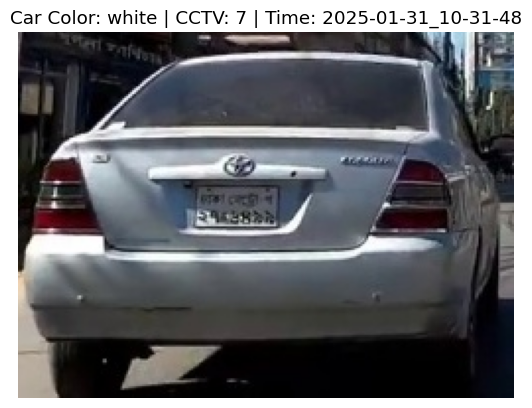

Loading image from: /content/results2/cctv8_23.7519-90.3368_2025-01-31_10-31-48.jpg_0.jpg


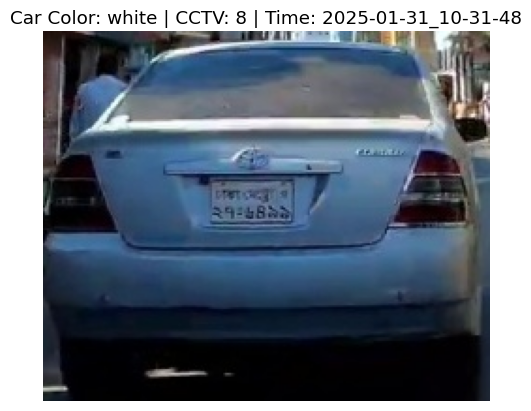

Loading image from: /content/results2/cctv5_23.7265-90.3334_2025-01-31_10-31-48.jpg_0.jpg


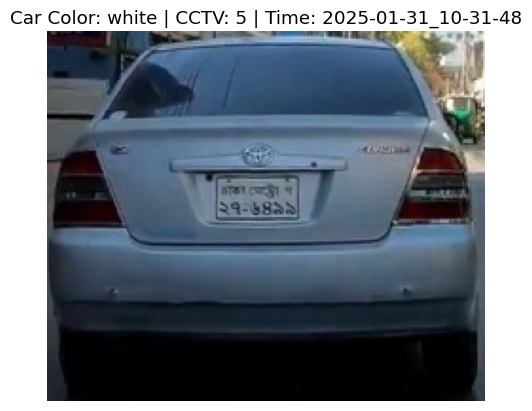

Loading image from: /content/results2/cctv7_23.878-90.4611_2025-01-31_10-31-48.jpg_0.jpg


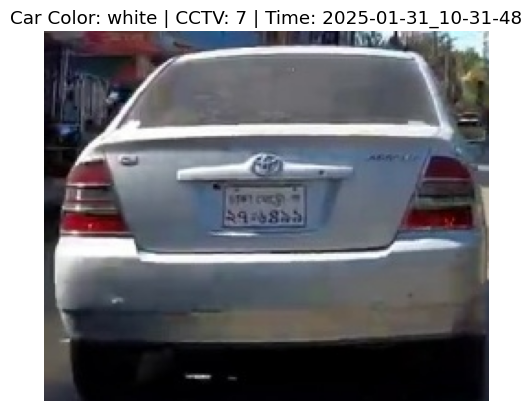

Loading image from: /content/results2/cctv7_23.8755-90.3707_2025-01-31_10-31-48.jpg_0.jpg


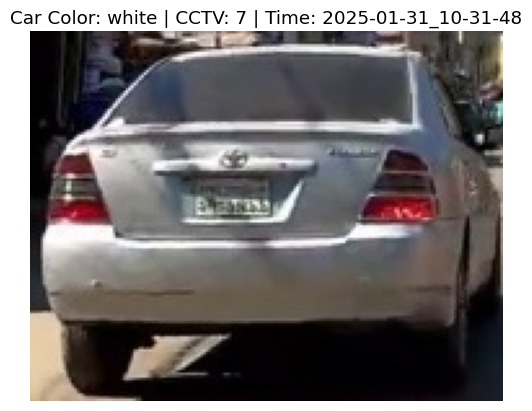

Loading image from: /content/results2/cctv3_23.7631-90.3513_2025-01-31_10-31-48.jpg_2.jpg


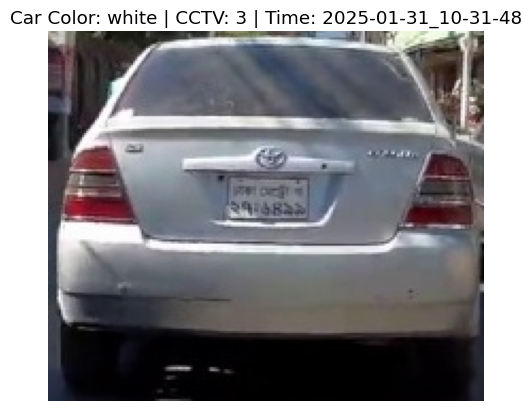

Loading image from: /content/results2/cctv6_23.8613-90.3845_2025-01-31_10-31-48.jpg_0.jpg


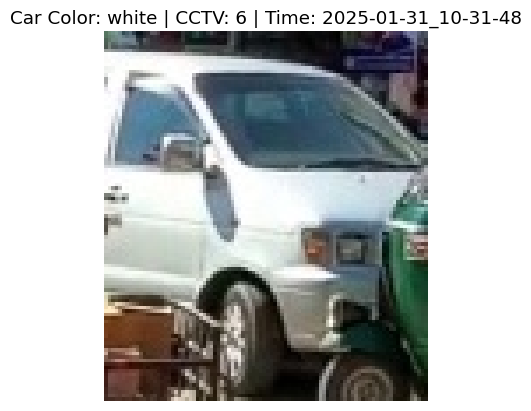

Loading image from: /content/results2/cctv4_23.8428-90.4394_2025-01-31_10-31-48.jpg_0.jpg


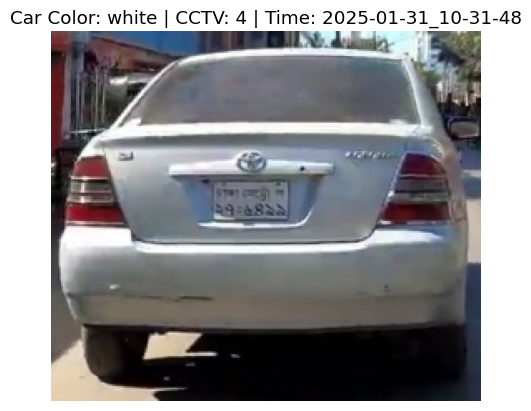

Loading image from: /content/results2/cctv10_23.7229-90.3733_2025-01-31_10-31-48.jpg_1.jpg


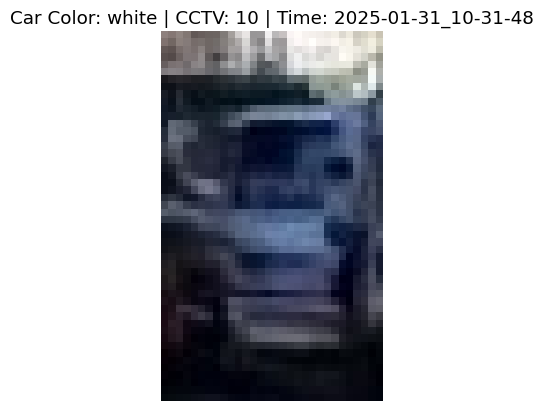

Loading image from: /content/results2/cctv8_23.7428-90.4984_2025-01-31_10-31-48.jpg_0.jpg


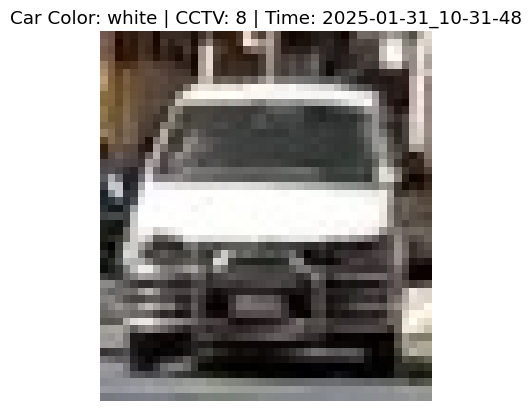

Loading image from: /content/results2/cctv9_23.8989-90.4415_2025-01-31_10-31-48.jpg_0.jpg


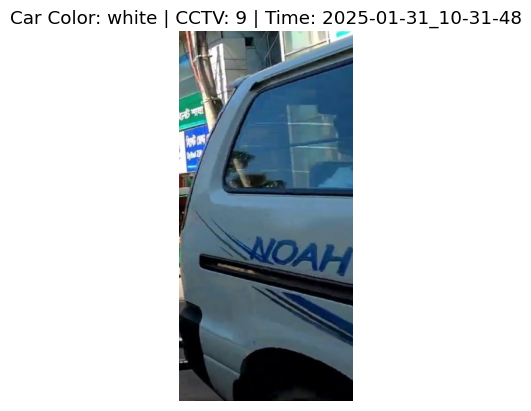

Loading image from: /content/results2/cctv4_23.8711-90.4834_2025-01-31_10-31-48.jpg_0.jpg


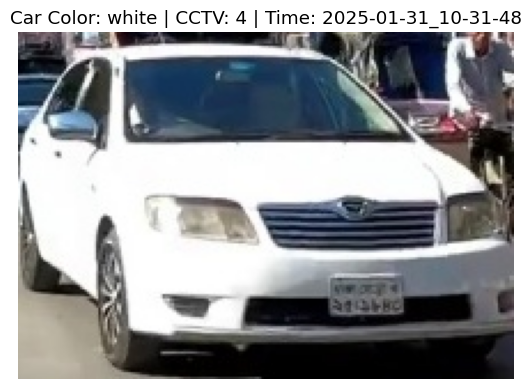

Loading image from: /content/results2/cctv1_23.7389-90.4866_2025-01-31_10-31-48.jpg_0.jpg


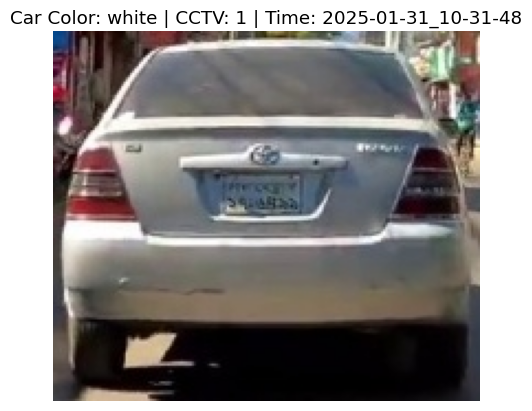

Loading image from: /content/results2/cctv10_23.7988-90.4634_2025-01-31_10-31-48.jpg_0.jpg


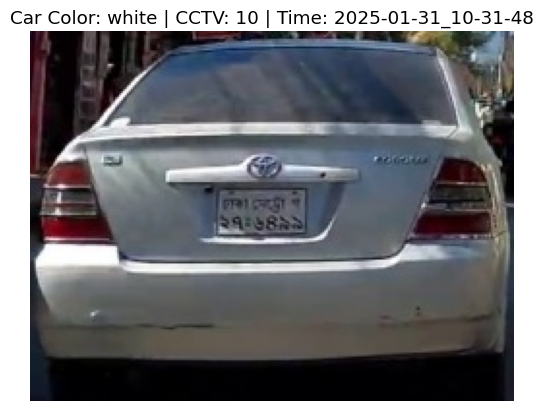

Loading image from: /content/results2/cctv6_23.7717-90.4855_2025-01-31_10-31-48.jpg_1.jpg


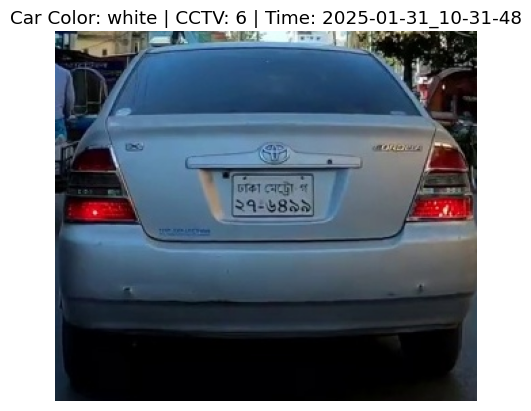

Loading image from: /content/results2/cctv8_23.8441-90.3327_2025-01-31_10-31-48.jpg_0.jpg


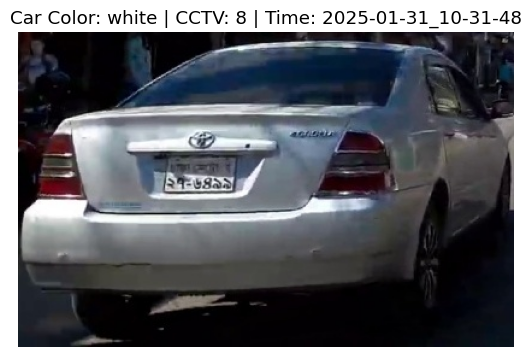

Loading image from: /content/results2/cctv5_23.8169-90.3931_2025-01-31_10-31-48.jpg_0.jpg


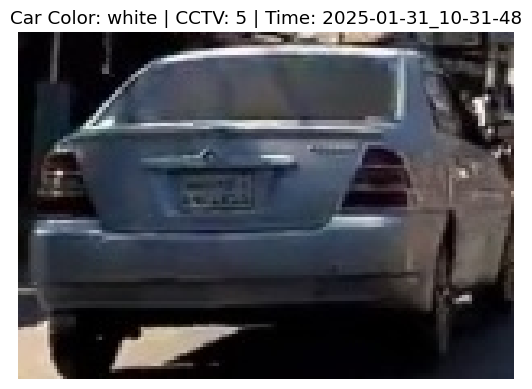

Loading image from: /content/results2/cctv2_23.8888-90.3743_2025-01-31_10-31-48.jpg_0.jpg


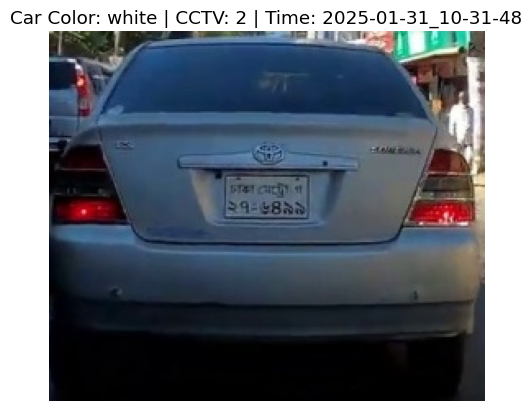

Loading image from: /content/results2/cctv5_23.7021-90.4772_2025-01-31_10-31-48.jpg_0.jpg


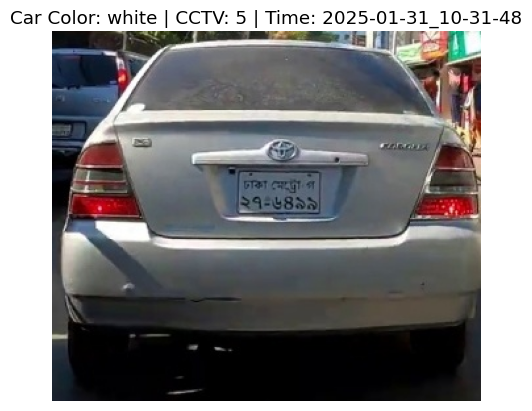

Loading image from: /content/results2/cctv4_23.7396-90.3852_2025-01-31_10-31-48.jpg_0.jpg


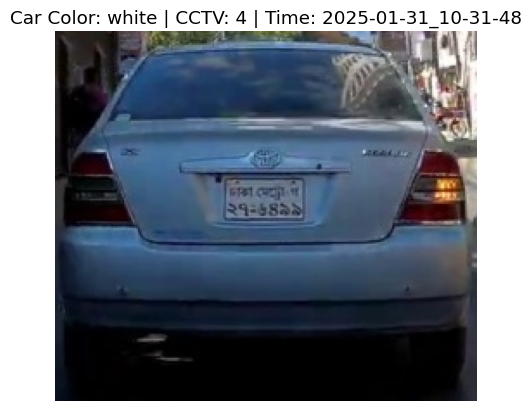

Loading image from: /content/results2/cctv10_23.7482-90.3103_2025-01-31_10-31-48.jpg_0.jpg


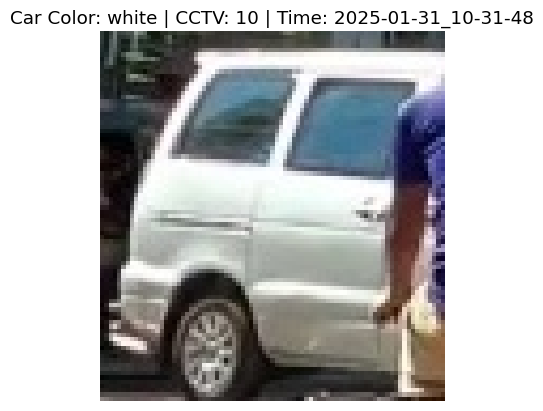

Loading image from: /content/results2/cctv10_23.7701-90.4396_2025-01-31_10-31-48.jpg_0.jpg


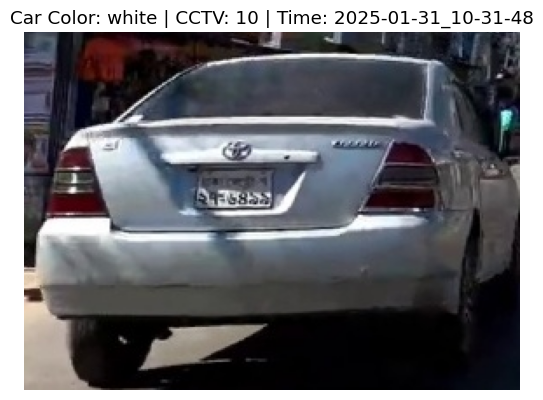

Loading image from: /content/results2/cctv10_23.7969-90.3326_2025-01-31_10-31-48.jpg_1.jpg


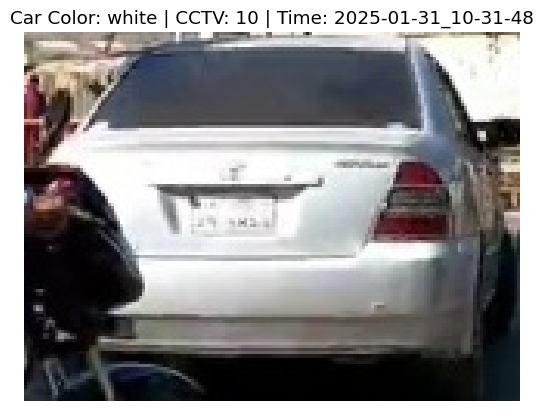

Loading image from: /content/results2/cctv3_23.7323-90.4977_2025-01-31_10-31-48.jpg_0.jpg


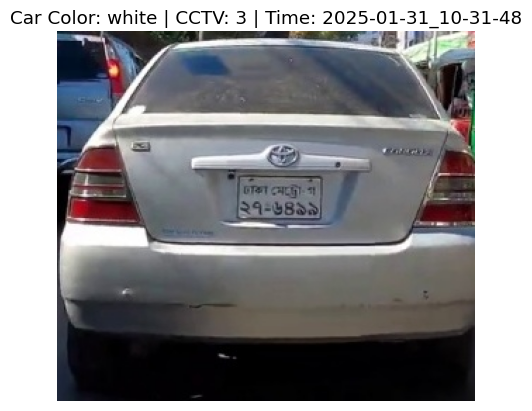

Loading image from: /content/results2/cctv9_23.7838-90.3221_2025-01-31_10-31-48.jpg_0.jpg


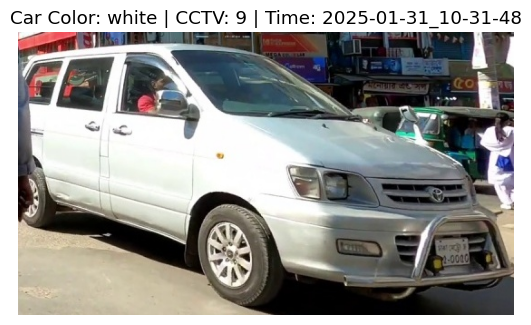

Loading image from: /content/results2/cctv10_23.7947-90.4855_2025-01-31_10-31-48.jpg_0.jpg


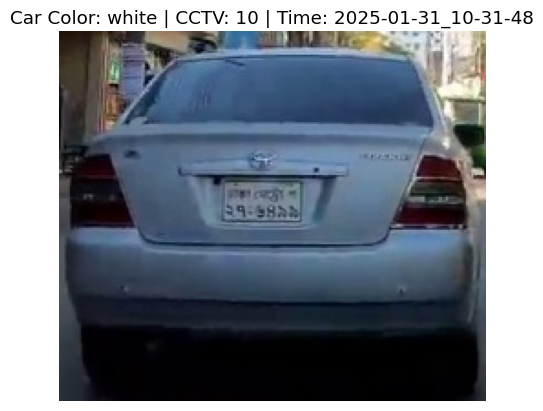

Loading image from: /content/results2/cctv8_23.8435-90.3922_2025-01-31_10-31-48.jpg_0.jpg


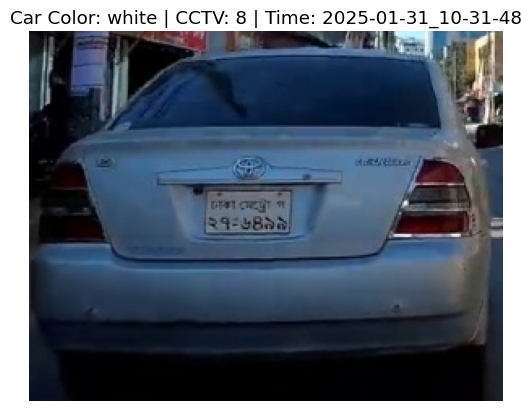

Loading image from: /content/results2/cctv10_23.8139-90.4748_2025-01-31_10-31-48.jpg_0.jpg


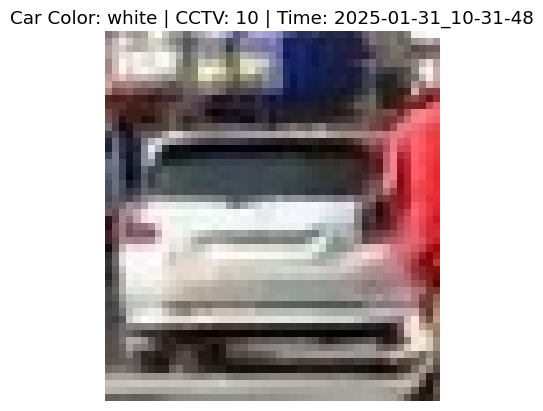

Loading image from: /content/results2/cctv2_23.8147-90.352_2025-01-31_10-31-48.jpg_0.jpg


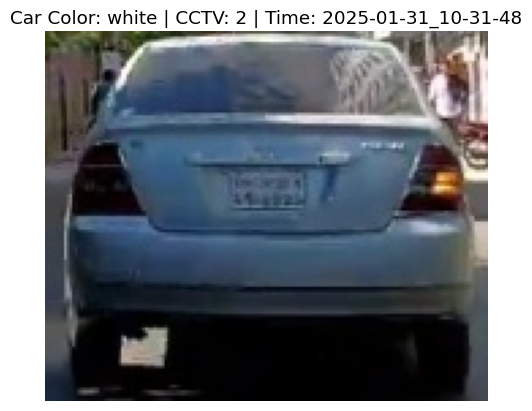

Loading image from: /content/results2/cctv4_23.822-90.3919_2025-01-31_10-31-48.jpg_1.jpg


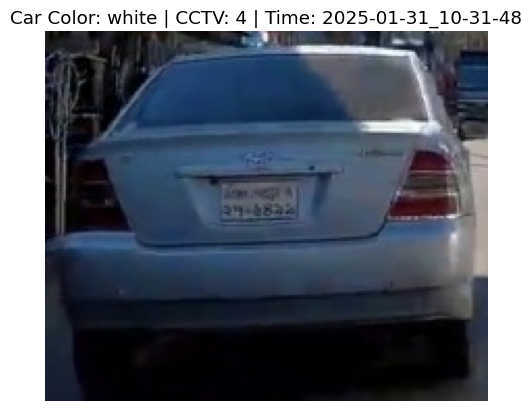

Loading image from: /content/results2/cctv7_23.7219-90.4003_2025-01-31_10-31-48.jpg_1.jpg


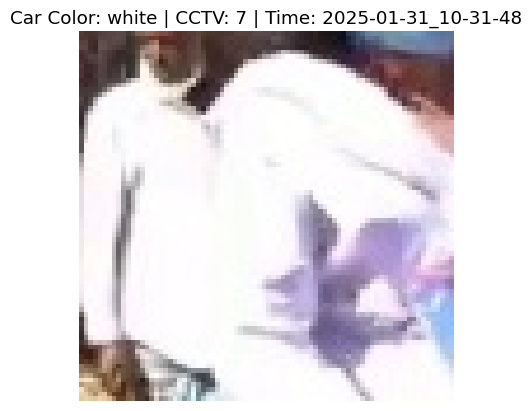

Loading image from: /content/results2/cctv9_23.8218-90.4962_2025-01-31_10-31-48.jpg_1.jpg


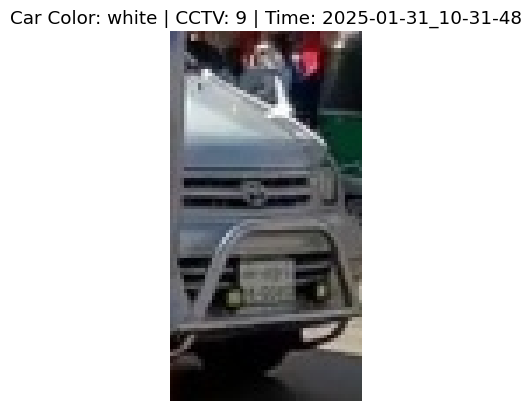

Loading image from: /content/results2/cctv7_23.7021-90.341_2025-01-31_10-31-48.jpg_0.jpg


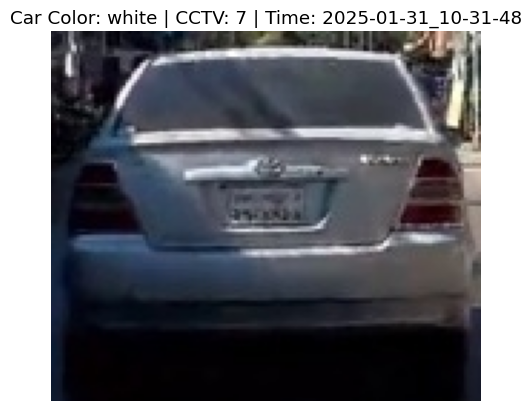

Loading image from: /content/results2/cctv3_23.7409-90.3343_2025-01-31_10-31-48.jpg_1.jpg


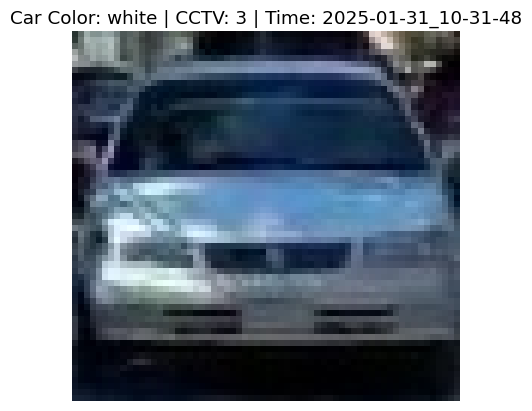

Loading image from: /content/results2/cctv9_23.7812-90.3061_2025-01-31_10-31-48.jpg_0.jpg


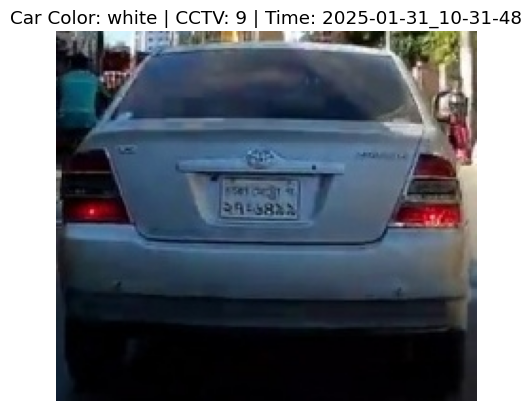

Loading image from: /content/results2/cctv8_23.8639-90.308_2025-01-31_10-31-48.jpg_0.jpg


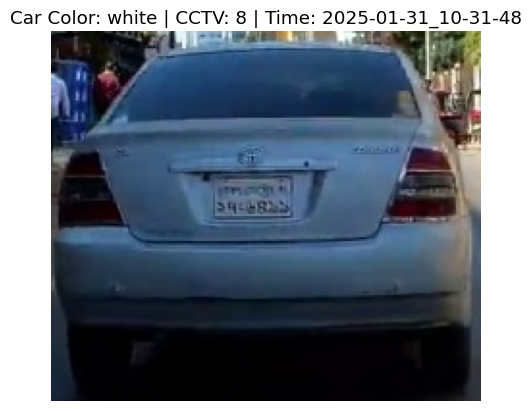

Loading image from: /content/results2/cctv6_23.7069-90.3669_2025-01-31_10-31-48.jpg_0.jpg


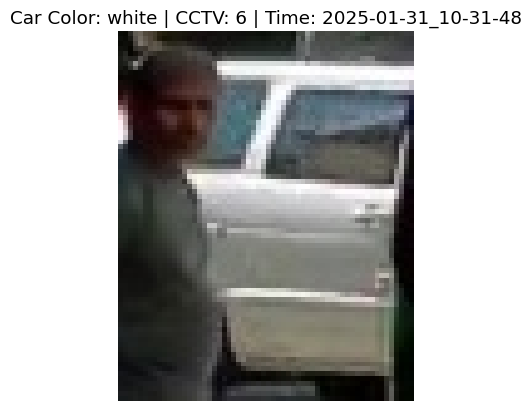

Loading image from: /content/results2/cctv10_23.7711-90.3663_2025-01-31_10-31-48.jpg_0.jpg


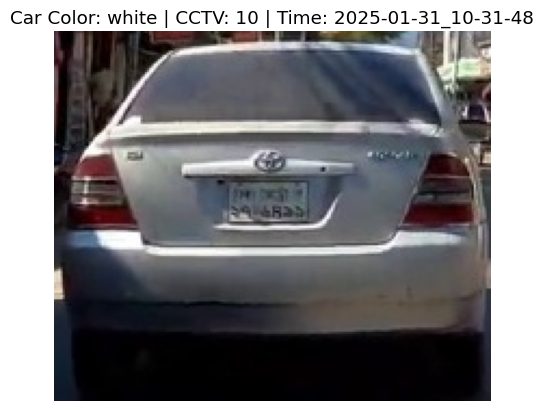

Loading image from: /content/results2/cctv1_23.8312-90.4658_2025-01-31_10-31-48.jpg_1.jpg


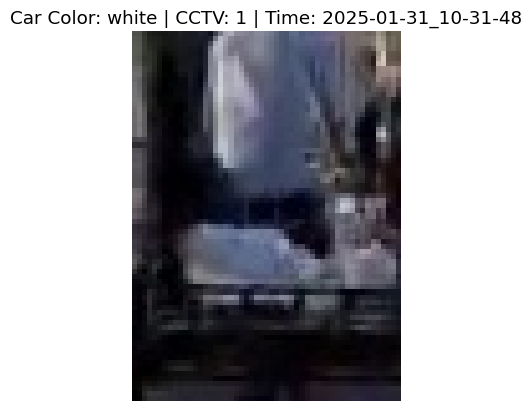

Loading image from: /content/results2/cctv7_23.8577-90.3974_2025-01-31_10-31-48.jpg_0.jpg


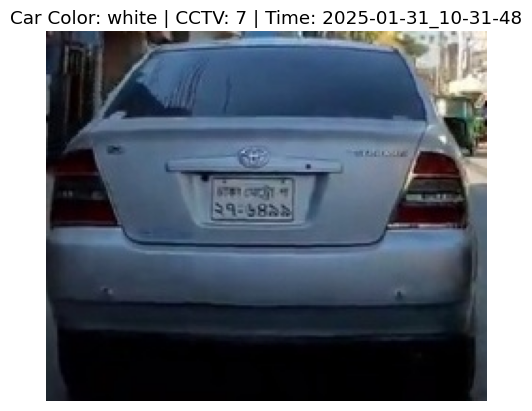

Loading image from: /content/results2/cctv10_23.7534-90.4263_2025-01-31_10-31-48.jpg_1.jpg


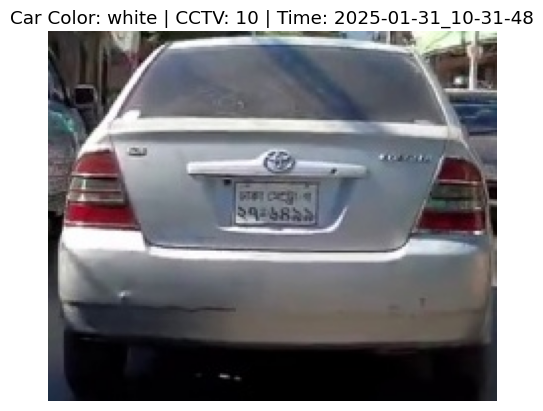

Loading image from: /content/results2/cctv3_23.7049-90.33_2025-01-31_10-31-48.jpg_0.jpg


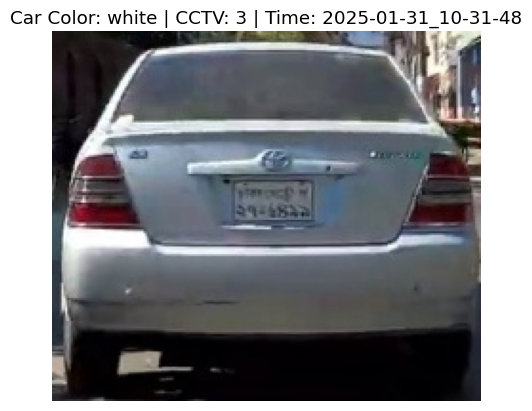

Loading image from: /content/results2/cctv6_23.7547-90.4471_2025-01-31_10-31-48.jpg_2.jpg


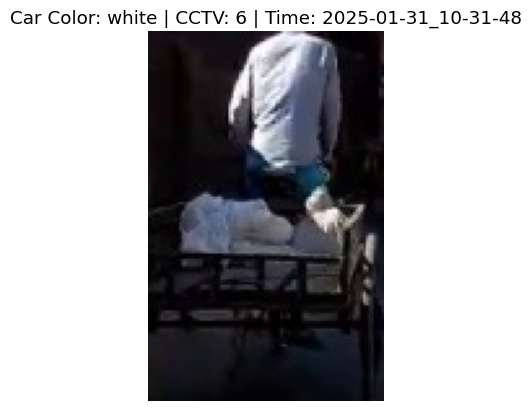

Loading image from: /content/results2/cctv8_23.8455-90.3964_2025-01-31_10-31-48.jpg_0.jpg


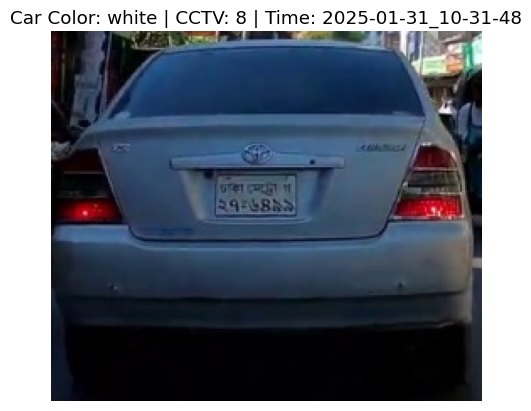

Loading image from: /content/results2/cctv6_23.8348-90.48_2025-01-31_10-31-48.jpg_0.jpg


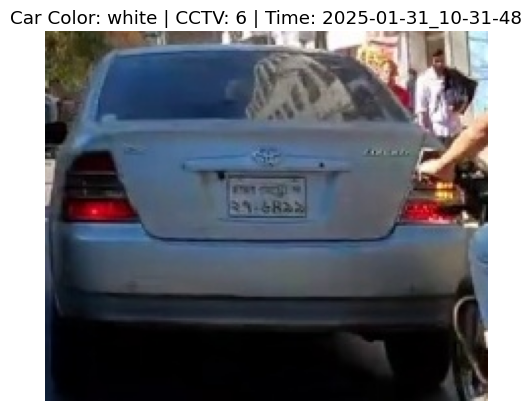

Loading image from: /content/results2/cctv1_23.866-90.4456_2025-01-31_10-31-48.jpg_0.jpg


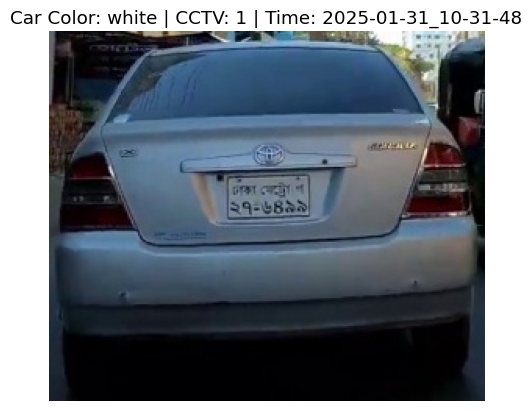

Loading image from: /content/results2/cctv3_23.7568-90.3771_2025-01-31_10-31-48.jpg_0.jpg


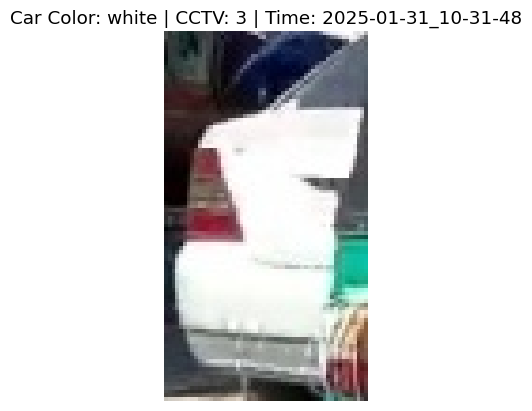

Loading image from: /content/results2/cctv6_23.7912-90.4918_2025-01-31_10-31-48.jpg_0.jpg


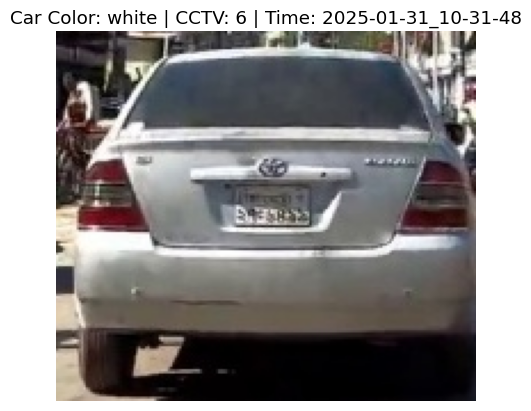

Loading image from: /content/results2/cctv10_23.7491-90.302_2025-01-31_10-31-48.jpg_0.jpg


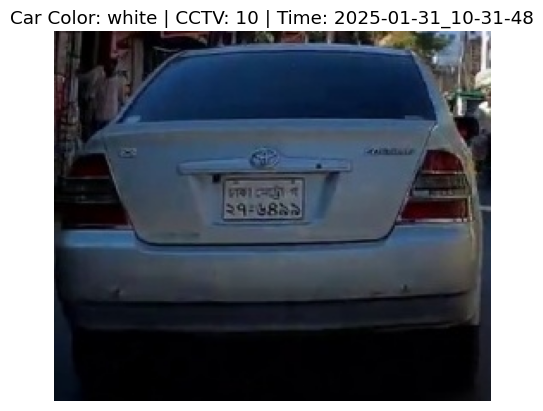

Loading image from: /content/results2/cctv3_23.8421-90.4949_2025-01-31_10-31-48.jpg_0.jpg


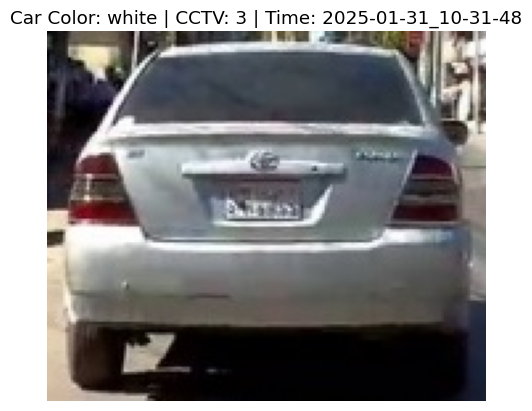

Loading image from: /content/results2/cctv10_23.7559-90.3841_2025-01-31_10-31-48.jpg_0.jpg


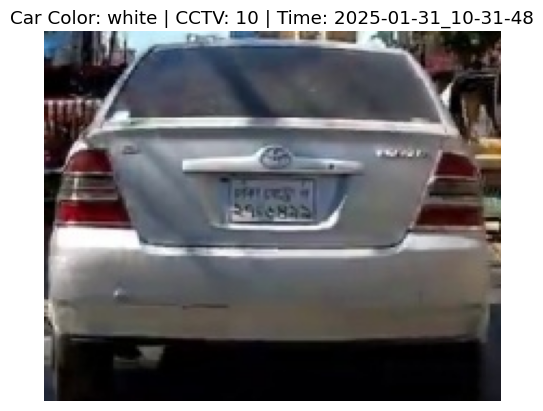

Loading image from: /content/results2/cctv1_23.7041-90.3334_2025-01-31_10-31-48.jpg_0.jpg


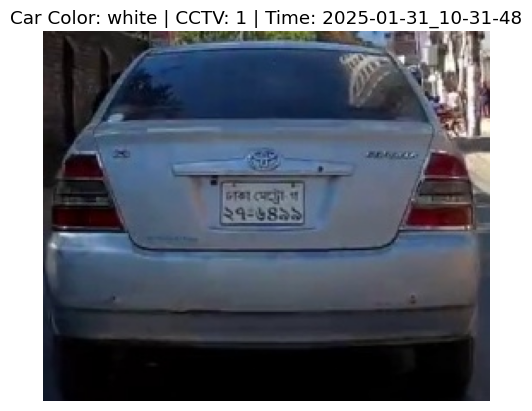

Loading image from: /content/results2/cctv7_23.7162-90.3313_2025-01-31_10-31-48.jpg_0.jpg


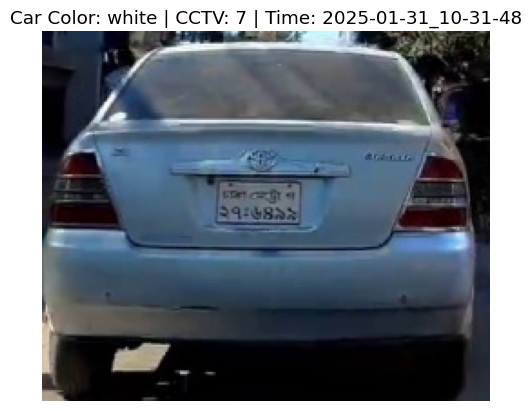

Loading image from: /content/results2/cctv9_23.7852-90.4635_2025-01-31_10-31-48.jpg_0.jpg


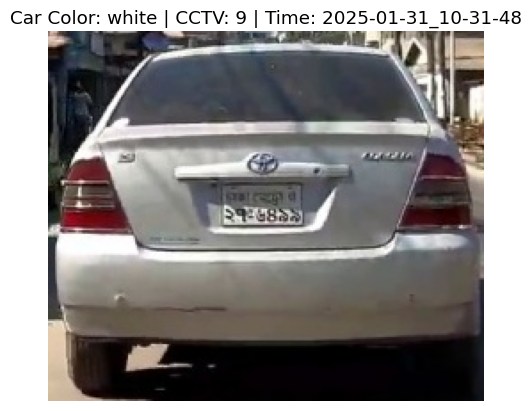

Loading image from: /content/results2/cctv8_23.8422-90.478_2025-01-31_10-31-48.jpg_0.jpg


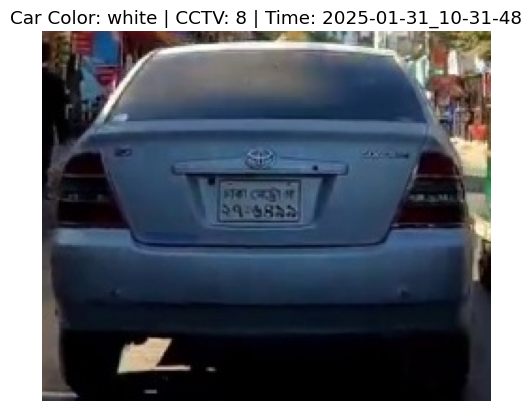

Loading image from: /content/results2/cctv1_23.7944-90.46_2025-01-31_10-31-48.jpg_0.jpg


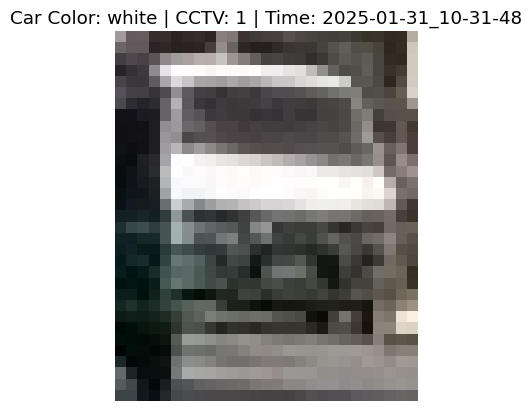

Loading image from: /content/results2/cctv6_23.8212-90.38_2025-01-31_10-31-48.jpg_0.jpg


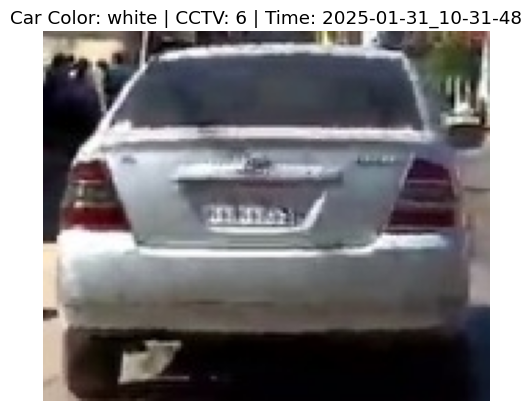

Loading image from: /content/results2/cctv7_23.7666-90.4075_2025-01-31_10-31-48.jpg_0.jpg


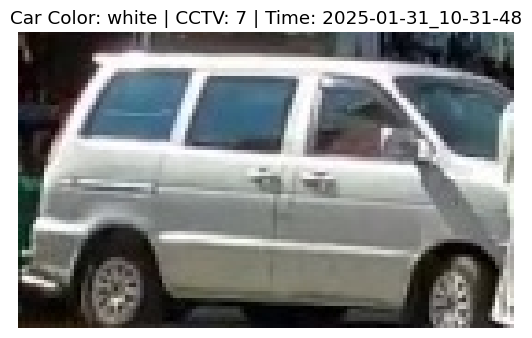

Loading image from: /content/results2/cctv2_23.7833-90.3429_2025-01-31_10-31-48.jpg_2.jpg


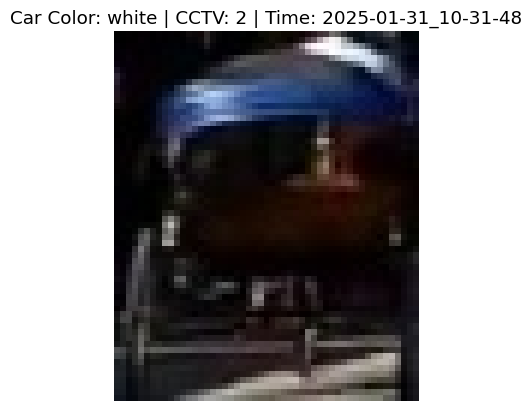

Loading image from: /content/results2/cctv2_23.8973-90.4542_2025-01-31_10-31-48.jpg_0.jpg


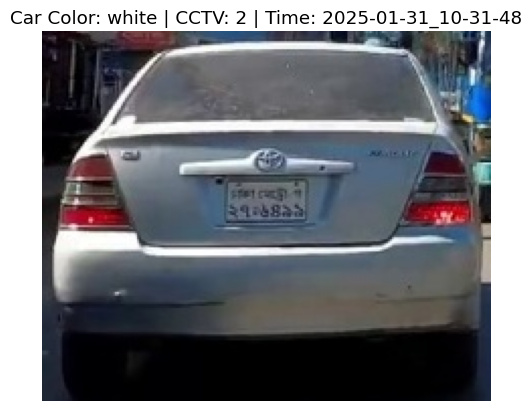

Loading image from: /content/results2/cctv5_23.7098-90.4971_2025-01-31_10-31-48.jpg_0.jpg


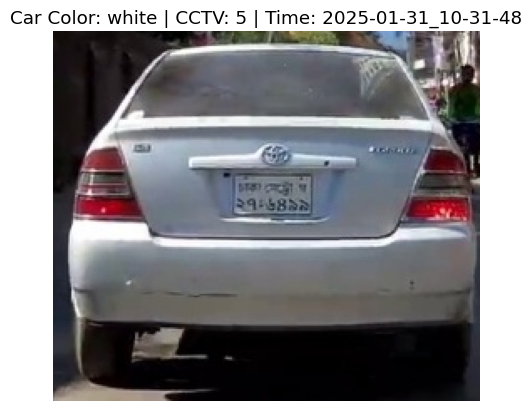

Loading image from: /content/results2/cctv4_23.8341-90.3079_2025-01-31_10-31-48.jpg_0.jpg


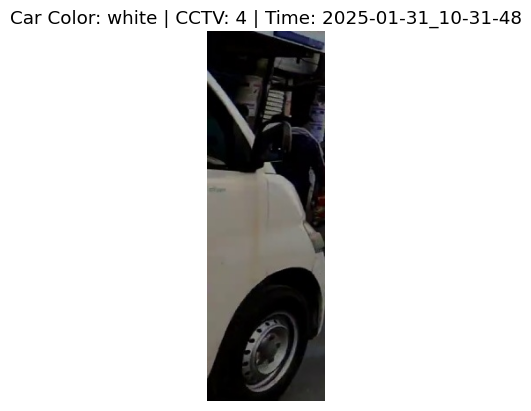

Loading image from: /content/results2/cctv10_23.8129-90.4747_2025-01-31_10-31-48.jpg_1.jpg


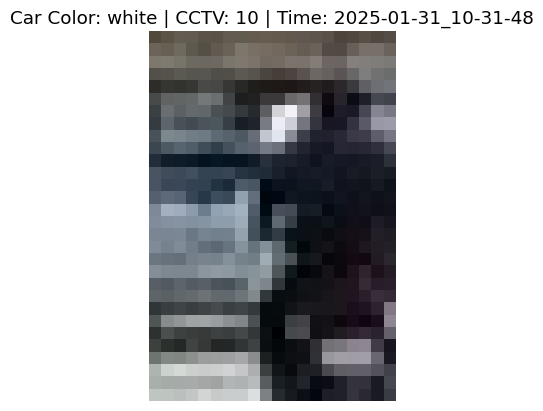

Loading image from: /content/results2/cctv9_23.8371-90.4782_2025-01-31_10-31-48.jpg_0.jpg


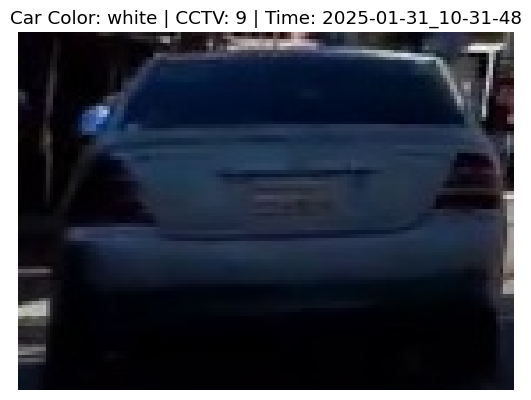

Loading image from: /content/results2/cctv7_23.8822-90.4915_2025-01-31_10-31-48.jpg_0.jpg


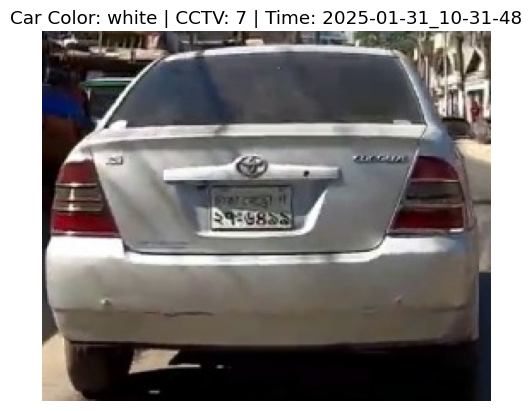

Loading image from: /content/results2/cctv3_23.7405-90.37_2025-01-31_10-31-48.jpg_0.jpg


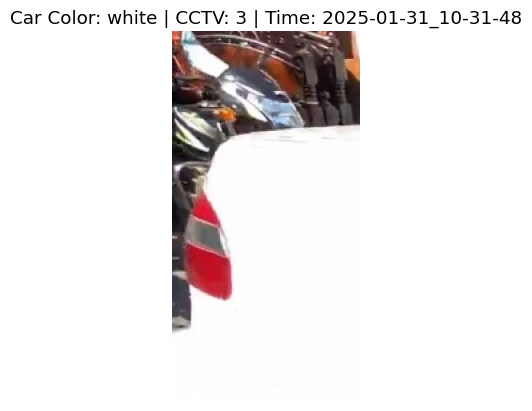

Loading image from: /content/results2/cctv1_23.77-90.4002_2025-01-31_10-31-48.jpg_0.jpg


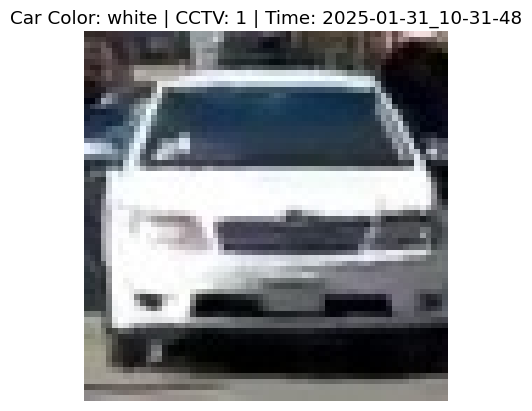

Loading image from: /content/results2/cctv9_23.8845-90.3768_2025-01-31_10-31-48.jpg_1.jpg


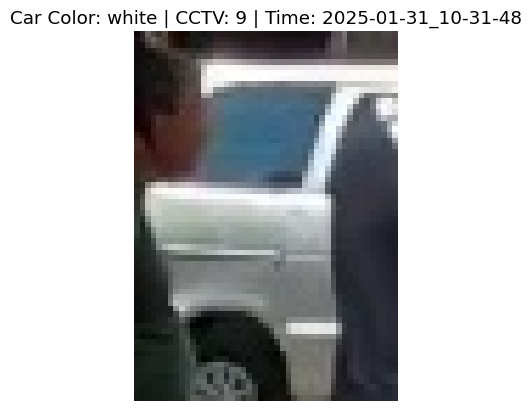

Loading image from: /content/results2/cctv6_23.8514-90.3581_2025-01-31_10-31-48.jpg_0.jpg


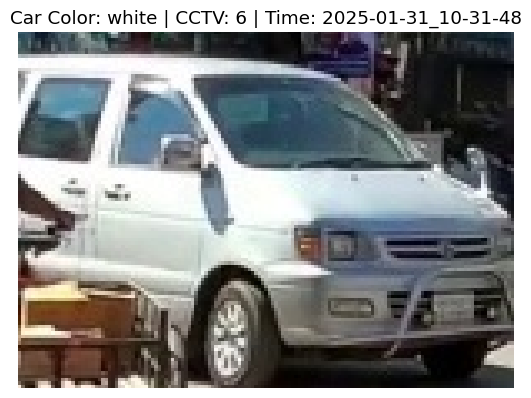

Loading image from: /content/results2/cctv4_23.7888-90.3055_2025-01-31_10-31-48.jpg_0.jpg


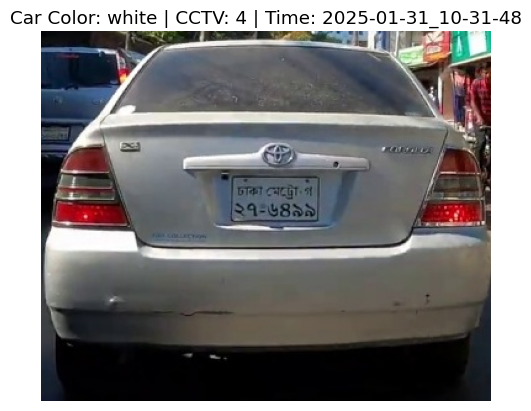

Loading image from: /content/results2/cctv4_23.8832-90.3984_2025-01-31_10-31-48.jpg_0.jpg


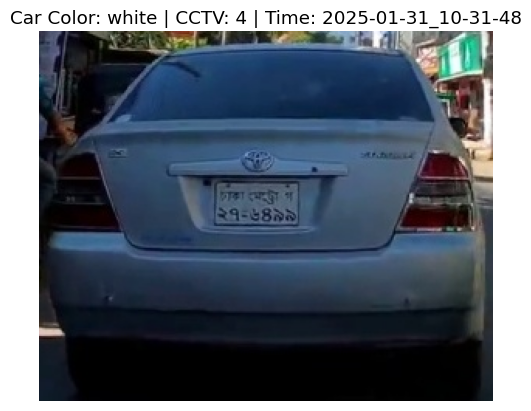

Loading image from: /content/results2/cctv3_23.8615-90.3359_2025-01-31_10-31-48.jpg_0.jpg


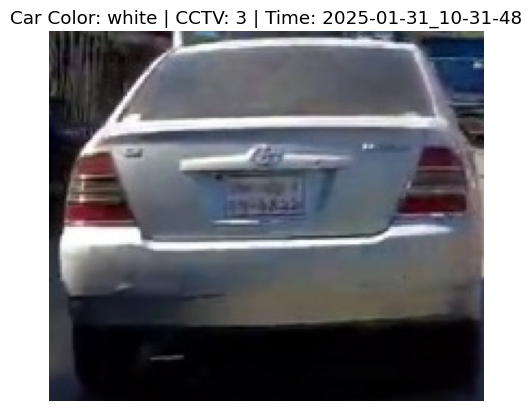

Loading image from: /content/results2/cctv2_23.8033-90.3864_2025-01-31_10-31-48.jpg_0.jpg


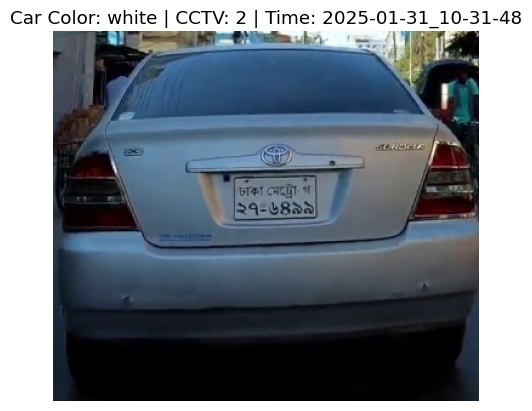

Loading image from: /content/results2/cctv3_23.8301-90.3903_2025-01-31_10-31-48.jpg_0.jpg


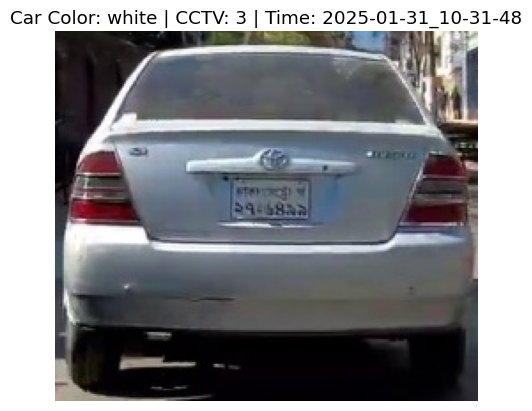

Loading image from: /content/results2/cctv3_23.7305-90.3037_2025-01-31_10-31-48.jpg_0.jpg


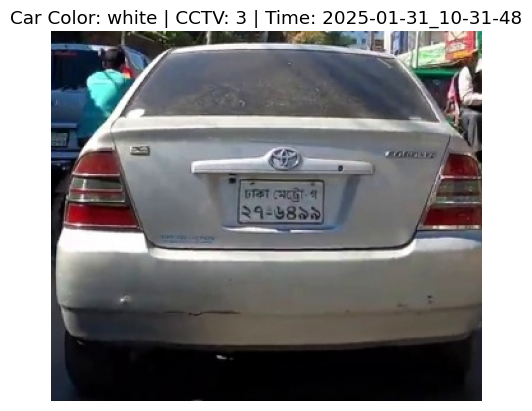

Loading image from: /content/results2/cctv7_23.775-90.379_2025-01-31_10-31-48.jpg_0.jpg


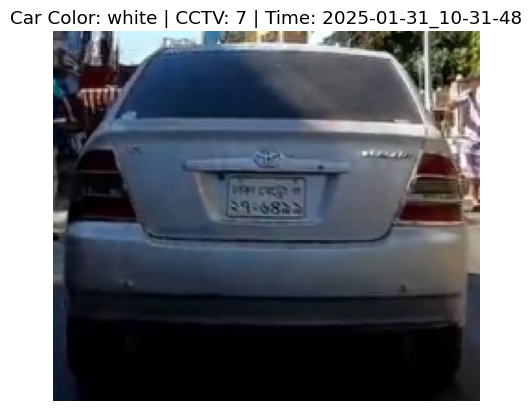

Loading image from: /content/results2/cctv9_23.8243-90.3495_2025-01-31_10-31-48.jpg_0.jpg


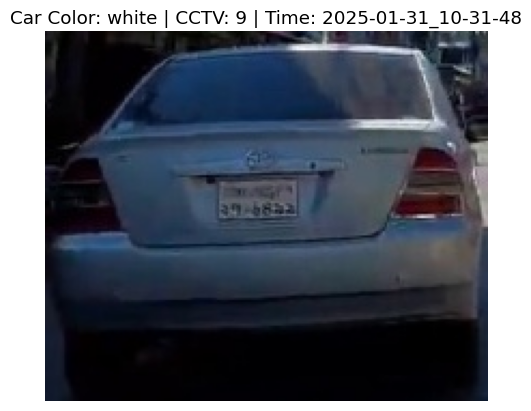

Loading image from: /content/results2/cctv10_23.8904-90.3105_2025-01-31_10-31-48.jpg_1.jpg


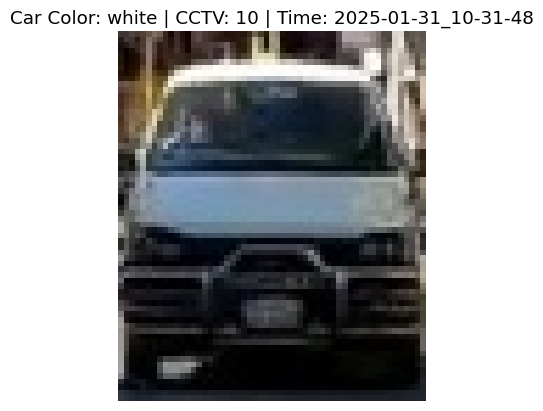

Loading image from: /content/results2/cctv10_23.7699-90.4306_2025-01-31_10-31-48.jpg_0.jpg


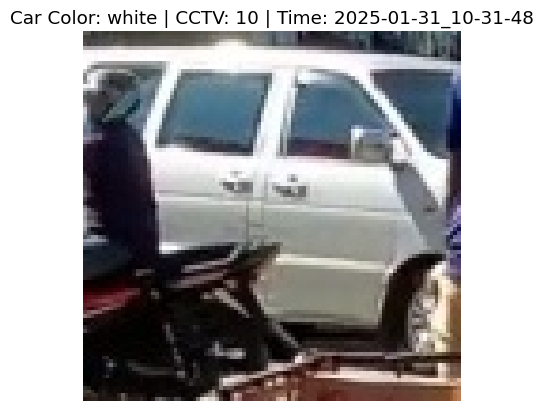

Loading image from: /content/results2/cctv8_23.8991-90.4834_2025-01-31_10-31-48.jpg_0.jpg


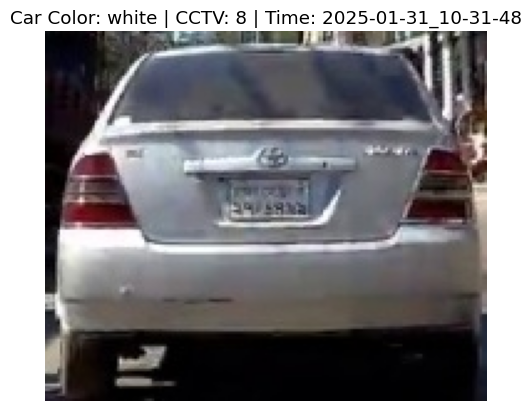

Loading image from: /content/results2/cctv3_23.7144-90.4734_2025-01-31_10-31-48.jpg_0.jpg


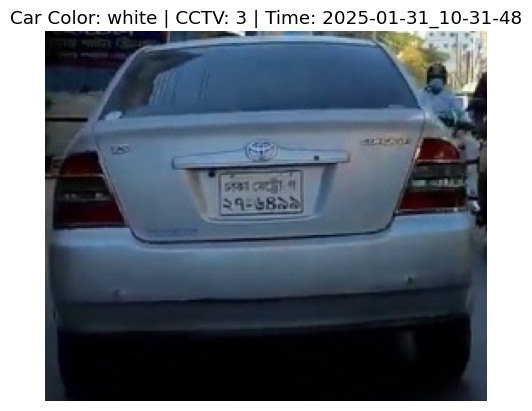

Loading image from: /content/results2/cctv6_23.8244-90.479_2025-01-31_10-31-48.jpg_0.jpg


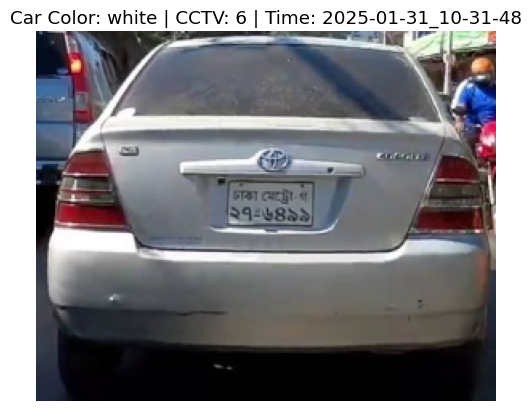

Loading image from: /content/results2/cctv5_23.7164-90.4707_2025-01-31_10-31-48.jpg_0.jpg


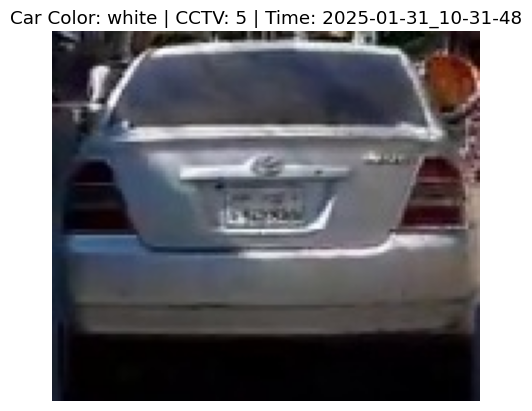

Loading image from: /content/results2/cctv5_23.7942-90.4486_2025-01-31_10-31-48.jpg_2.jpg


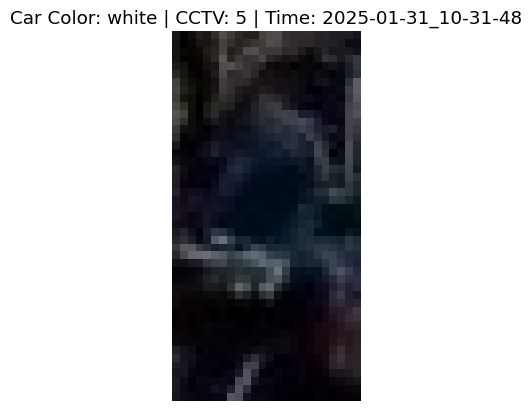

Loading image from: /content/results2/cctv2_23.8369-90.4055_2025-01-31_10-31-48.jpg_0.jpg


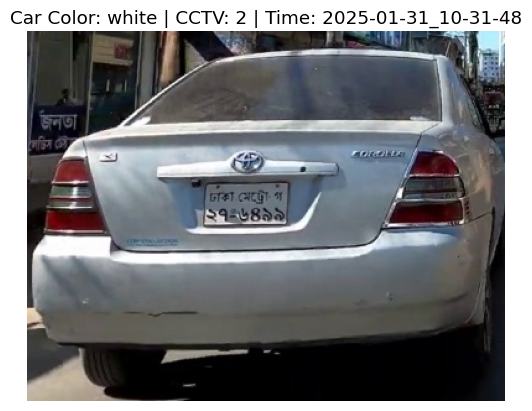

Loading image from: /content/results2/cctv6_23.7538-90.4061_2025-01-31_10-31-48.jpg_0.jpg


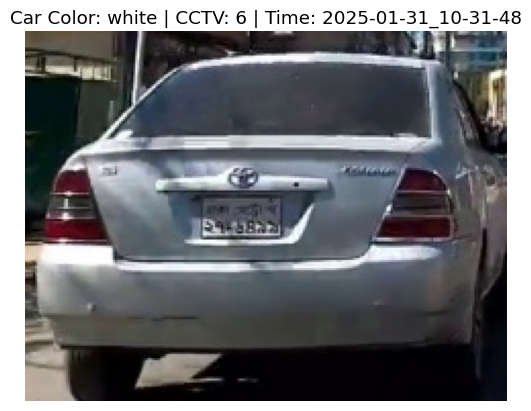

Loading image from: /content/results2/cctv1_23.8314-90.4688_2025-01-31_10-31-48.jpg_0.jpg


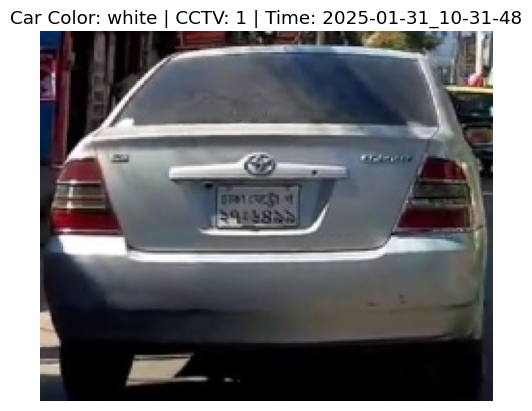

Loading image from: /content/results2/cctv6_23.8572-90.3831_2025-01-31_10-31-48.jpg_0.jpg


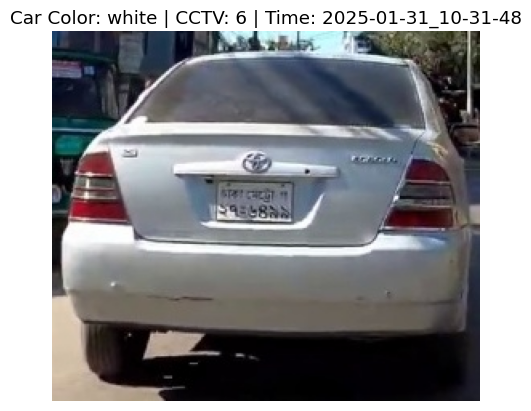

Loading image from: /content/results2/cctv2_23.7613-90.4247_2025-01-31_10-31-48.jpg_2.jpg


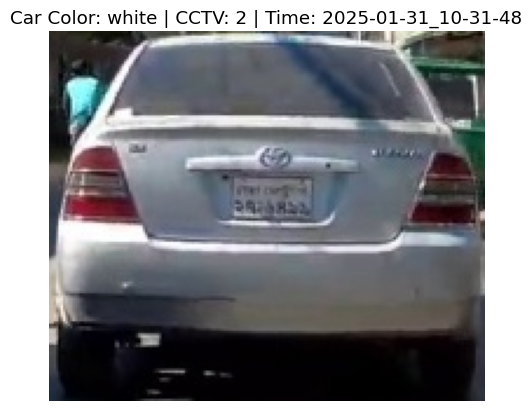

Loading image from: /content/results2/cctv10_23.7219-90.4553_2025-01-31_10-31-48.jpg_0.jpg


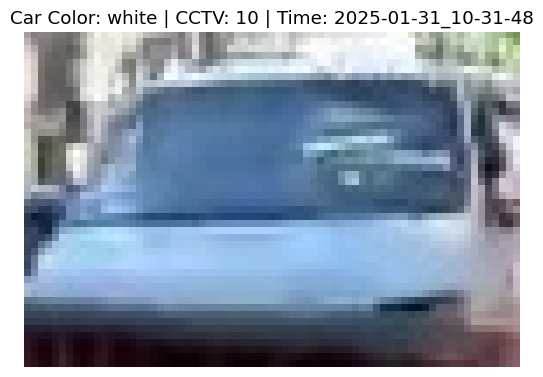

Loading image from: /content/results2/cctv1_23.8634-90.3394_2025-01-31_10-31-48.jpg_0.jpg


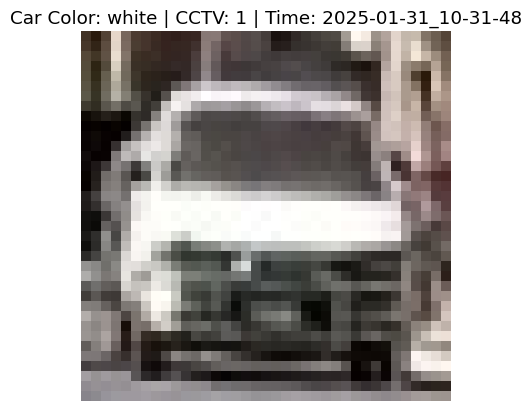

Loading image from: /content/results2/cctv9_23.8956-90.3751_2025-01-31_10-31-48.jpg_0.jpg


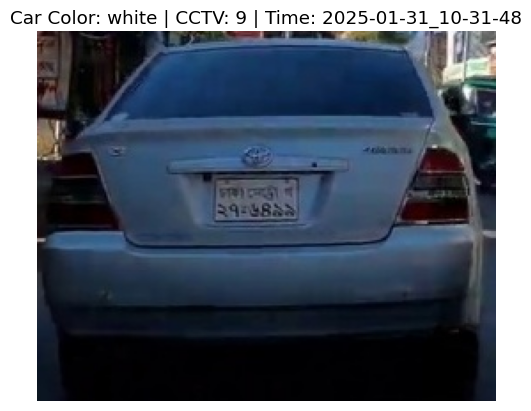

Loading image from: /content/results2/cctv2_23.8217-90.4335_2025-01-31_10-31-48.jpg_0.jpg


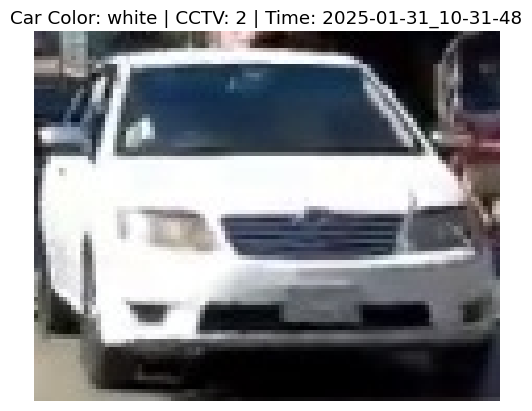

Loading image from: /content/results2/cctv3_23.7435-90.4094_2025-01-31_10-31-48.jpg_0.jpg


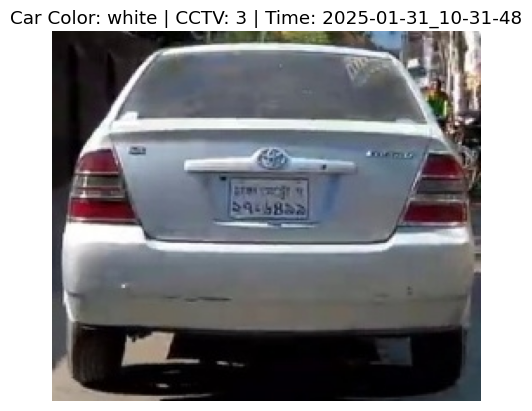

Loading image from: /content/results2/cctv10_23.8162-90.4786_2025-01-31_10-31-48.jpg_0.jpg


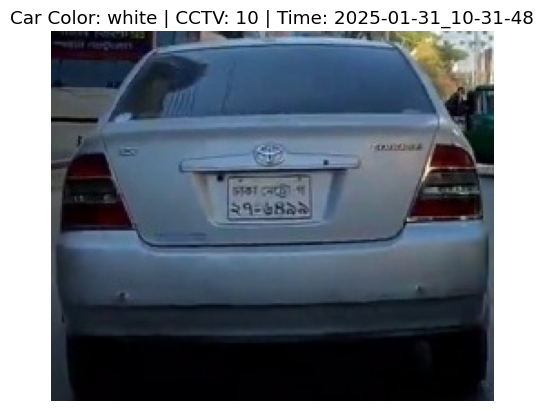

Loading image from: /content/results2/cctv6_23.8331-90.3698_2025-01-31_10-31-48.jpg_0.jpg


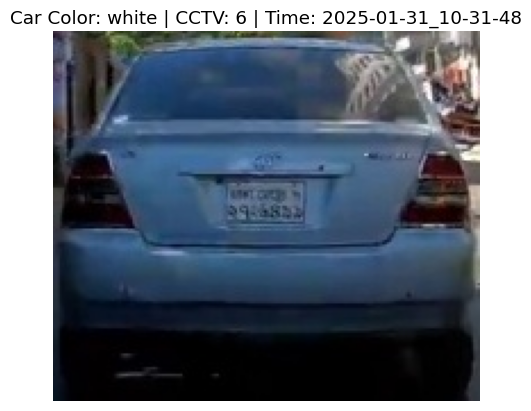

Loading image from: /content/results2/cctv5_23.7521-90.3501_2025-01-31_10-31-48.jpg_0.jpg


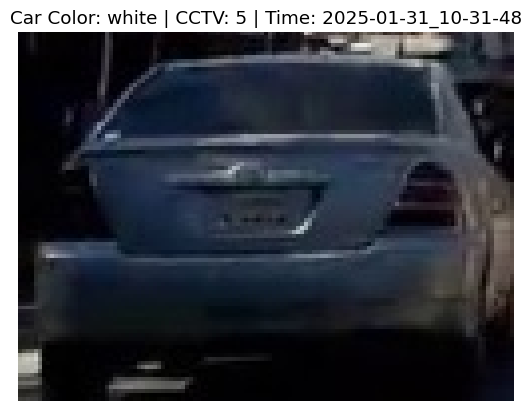

Loading image from: /content/results2/cctv8_23.8451-90.3739_2025-01-31_10-31-48.jpg_0.jpg


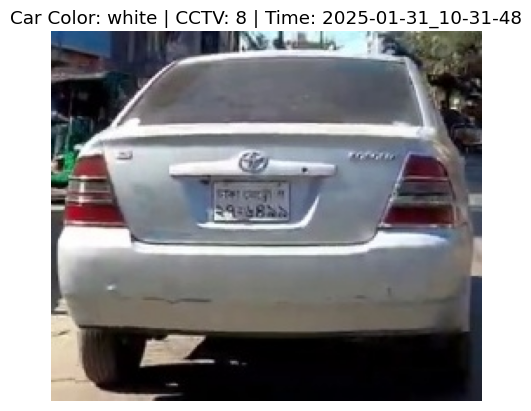

Loading image from: /content/results2/cctv8_23.7418-90.3731_2025-01-31_10-31-48.jpg_0.jpg


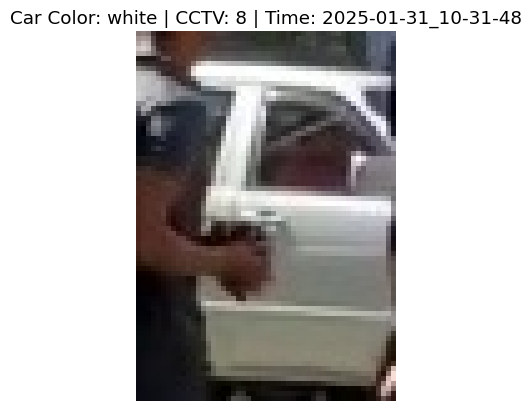

Loading image from: /content/results2/cctv7_23.8688-90.4067_2025-01-31_10-31-48.jpg_1.jpg


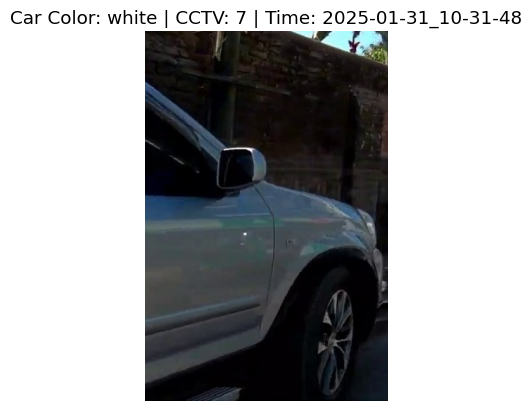

Loading image from: /content/results2/cctv6_23.8605-90.4654_2025-01-31_10-31-48.jpg_0.jpg


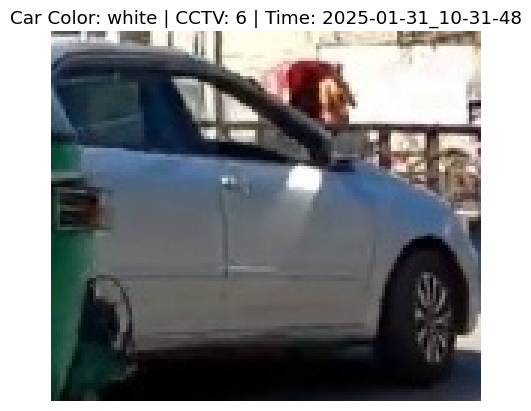

Loading image from: /content/results2/cctv5_23.7186-90.4185_2025-01-31_10-31-48.jpg_0.jpg


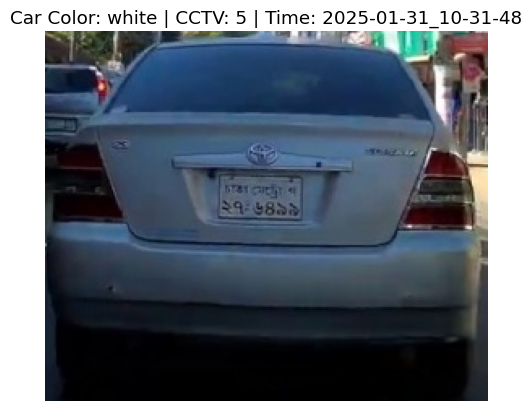

Loading image from: /content/results2/cctv10_23.8389-90.3103_2025-01-31_10-31-48.jpg_0.jpg


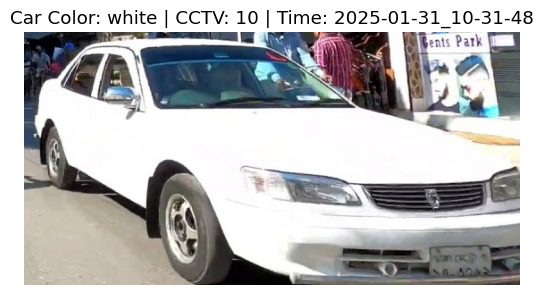

Loading image from: /content/results2/cctv5_23.8894-90.4128_2025-01-31_10-31-48.jpg_0.jpg


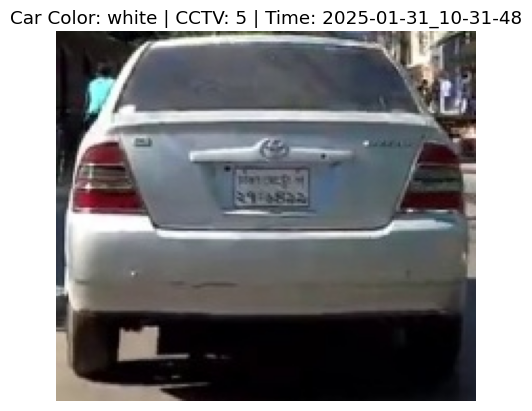

Loading image from: /content/results2/cctv4_23.8032-90.408_2025-01-31_10-31-48.jpg_0.jpg


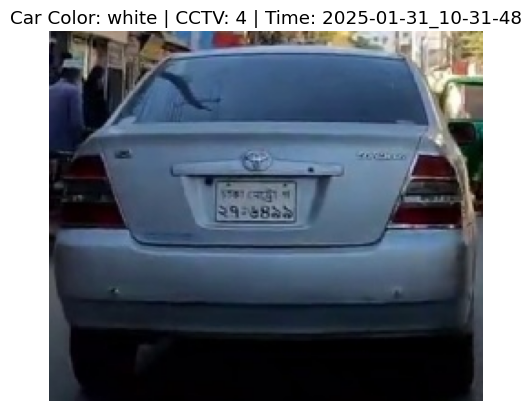

Loading image from: /content/results2/cctv4_23.8915-90.4725_2025-01-31_10-31-48.jpg_0.jpg


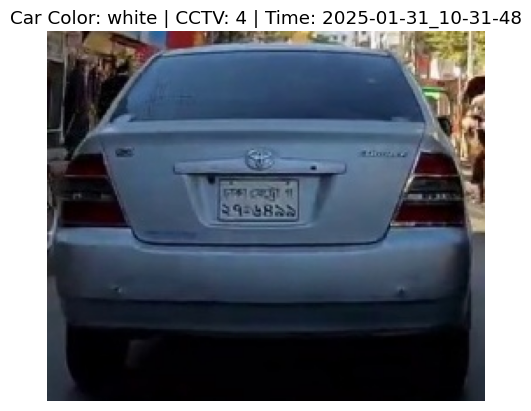

Loading image from: /content/results2/cctv8_23.8841-90.4561_2025-01-31_10-31-48.jpg_0.jpg


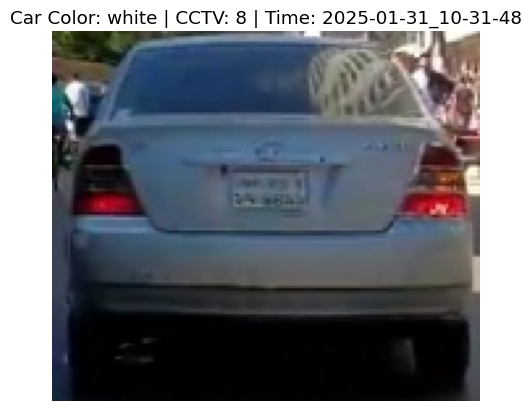

Loading image from: /content/results2/cctv1_23.7366-90.3023_2025-01-31_10-31-48.jpg_0.jpg


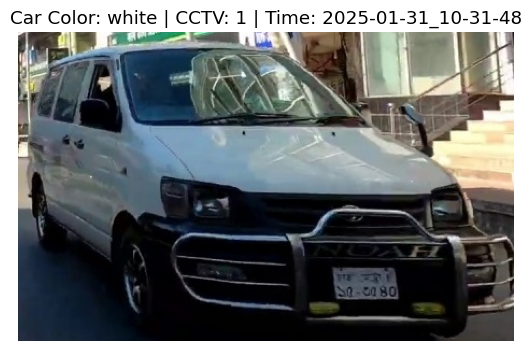

Loading image from: /content/results2/cctv7_23.7852-90.4689_2025-01-31_10-31-48.jpg_0.jpg


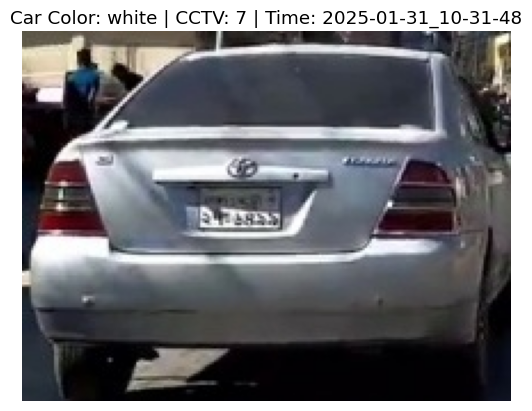

Loading image from: /content/results2/cctv3_23.8562-90.4505_2025-01-31_10-31-48.jpg_0.jpg


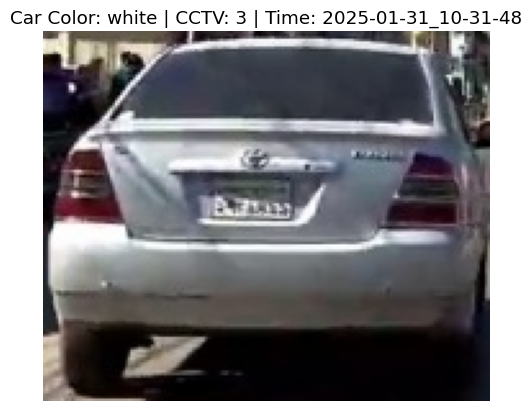

Loading image from: /content/results2/cctv5_23.8224-90.3735_2025-01-31_10-31-48.jpg_0.jpg


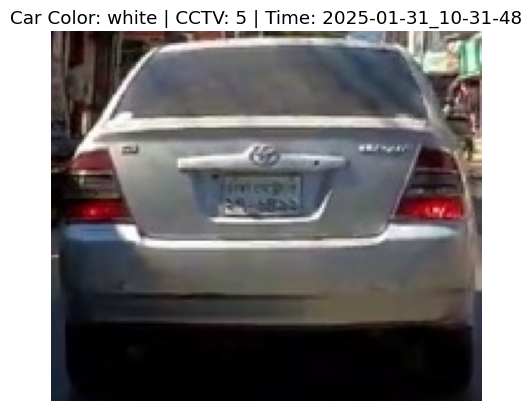

Loading image from: /content/results2/cctv9_23.8646-90.3187_2025-01-31_10-31-48.jpg_1.jpg


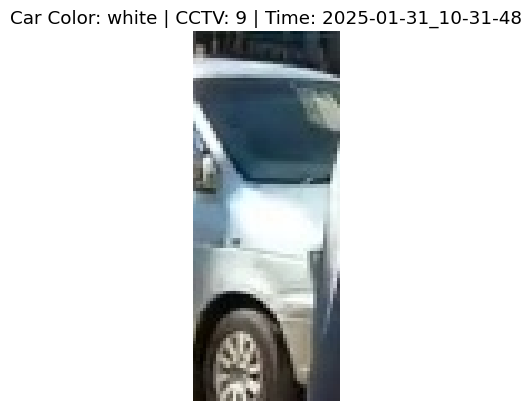

Loading image from: /content/results2/cctv1_23.889-90.3037_2025-01-31_10-31-48.jpg_0.jpg


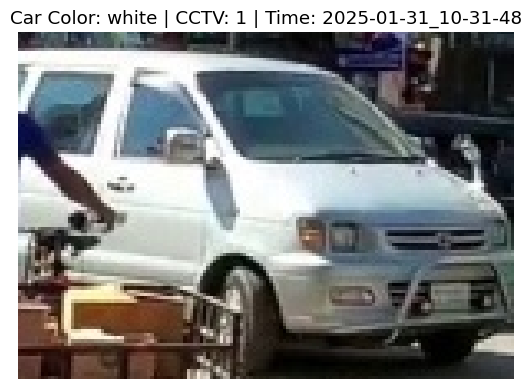

Loading image from: /content/results2/cctv1_23.7939-90.4807_2025-01-31_10-31-48.jpg_1.jpg


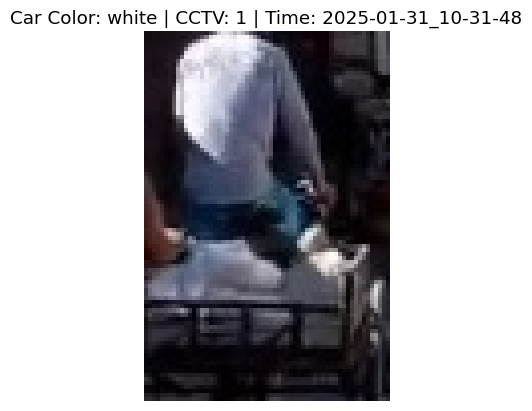

Loading image from: /content/results2/cctv5_23.8684-90.3584_2025-01-31_10-31-48.jpg_1.jpg


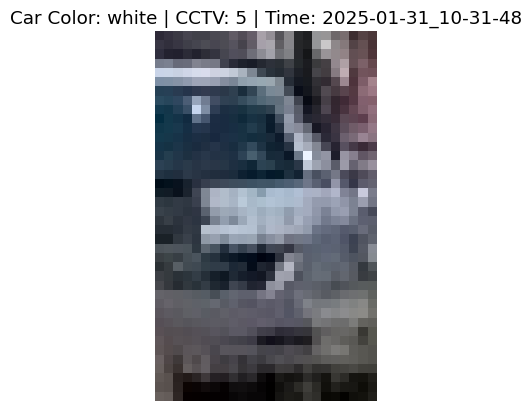

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# List of image metadata
image_data = output

# Folder path where images are stored
folder_path = '/content/results/'

# Display images
for data in image_data:
    image_path = data['frameTitle'] # Get the full image path
    print(f"Loading image from: {image_path}")  # Debug: Print the path

    img = cv2.imread(image_path)  # Read the image

    if img is None:
        print(f"Error loading image: {image_path}")
        continue  # Skip to the next image if loading fails

    # Convert image from BGR to RGB for correct display in Matplotlib
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Display the image
    plt.imshow(img_rgb)
    plt.title(f"Car Color: {data['carColor']} | CCTV: {data['cctv']} | Time: {data['time']}")
    plt.axis('off')  # Hide axes
    plt.show()


In [ ]:
#2nd model
from ultralytics import YOLO
import cv2
for data in image_data:
    image_path = os.path.join(folder_path, data['frameTitle'])  # Get the full image path
    print(f"Loading image from: {image_path}")  # Debug: Print the path



    # Load trained YOLOv8 model
    model = YOLO("/content/license_plate_detector.pt")

    # Read image
    image = cv2.imread(image_path)

    # Run inference
    results = model(image)

    # Extract bounding boxes
    for result in results:
        for box in result.boxes.xyxy:  # Get bounding box (x1, y1, x2, y2)
            x1, y1, x2, y2 = map(int, box)
            plate_img = image[y1:y2, x1:x2]  # Crop detected plate

            # Save cropped image
            cv2.imwrite("plate/plate.jpg", plate_img)


NameError: name 'image_data' is not defined

In [ ]:
#2nd model
from ultralytics import YOLO
import cv2


# Load trained YOLOv8 model
model = YOLO("/content/license_plate_detector.pt")

    # Read image
image = cv2.imread('/content/crop (1).jpg')

    # Run inference
results = model(image)



    # Extract bounding boxes
for result in results:
        for box in result.boxes.xyxy:  # Get bounding box (x1, y1, x2, y2)
            x1, y1, x2, y2 = map(int, box)
            plate_img = image[y1:y2, x1:x2]  # Crop detected plate

            # Save cropped image
            cv2.imwrite("/content/plate.jpg", plate_img)



0: 512x640 1 license_plate, 12.6ms
Speed: 3.6ms preprocess, 12.6ms inference, 1.9ms postprocess per image at shape (1, 3, 512, 640)


In [ ]:
import os
import random
import datetime

def generate_random_filename():
    """
    Generates a random filename in the format:
    cctv<ID>_<latitude>-<longitude>_<YYYY-MM-DD_HH-MM-SS>.jpg

    Returns:
        str: The generated filename.
    """
    cctv_id = random.randint(1, 10)  # Random CCTV ID (1-10)
    latitude = round(random.uniform(23.7000, 23.9000), 4)  # Random latitude in Dhaka range
    longitude = round(random.uniform(90.3000, 90.5000), 4)  # Random longitude in Dhaka range
    timestamp = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")  # Current timestamp

    return f"cctv{cctv_id}_{latitude}-{longitude}_{timestamp}.jpg"

def rename_files_in_folder(folder_path):
    """
    Renames all image files in the given folder to a random structured format.

    Parameters:
        folder_path (str): Path to the folder containing images.

    Returns:
        list: A list of tuples (old_name, new_name).
    """
    renamed_files = []
    if not os.path.exists(folder_path):
        print(f"Error: Folder '{folder_path}' not found.")
        return []

    for file_name in os.listdir(folder_path):
        if file_name.lower().endswith(('.jpg', '.jpeg', '.png')):  # Process image files only
            old_path = os.path.join(folder_path, file_name)
            new_name = generate_random_filename()
            new_path = os.path.join(folder_path, new_name)

            os.rename(old_path, new_path)
            renamed_files.append((file_name, new_name))

    return renamed_files

# Example Usage
folder_path = "/content/drive/MyDrive/L-6/car that we are searching"
renamed_files = rename_files_in_folder(folder_path)

for old, new in renamed_files:
    print(f"Renamed: {old} → {new}")


Renamed: 3648.jpg → cctv8_23.8348-90.406_2025-02-14_00-22-54.jpg
Renamed: 3644.jpg → cctv6_23.8117-90.3322_2025-02-14_00-22-54.jpg
Renamed: 3649.jpg → cctv6_23.8827-90.3592_2025-02-14_00-22-54.jpg
Renamed: 3645.jpg → cctv9_23.8585-90.4046_2025-02-14_00-22-54.jpg
Renamed: 3646.jpg → cctv1_23.769-90.3666_2025-02-14_00-22-54.jpg
Renamed: 3651.jpg → cctv8_23.8741-90.3768_2025-02-14_00-22-54.jpg
Renamed: 3650.jpg → cctv5_23.8493-90.449_2025-02-14_00-22-54.jpg
Renamed: 3661.jpg → cctv2_23.8563-90.4369_2025-02-14_00-22-54.jpg
Renamed: 3677.jpg → cctv5_23.8029-90.4721_2025-02-14_00-22-54.jpg
Renamed: 3678.jpg → cctv8_23.7891-90.4654_2025-02-14_00-22-54.jpg
Renamed: 3689.jpg → cctv10_23.8595-90.4199_2025-02-14_00-22-54.jpg
Renamed: 3674.jpg → cctv2_23.7699-90.3358_2025-02-14_00-22-54.jpg
Renamed: 3688.jpg → cctv10_23.7851-90.3209_2025-02-14_00-22-54.jpg
Renamed: 3695.jpg → cctv9_23.7117-90.323_2025-02-14_00-22-54.jpg
Renamed: 3680.jpg → cctv7_23.8404-90.348_2025-02-14_00-22-54.jpg
Renamed: 3673

In [ ]:
!pip install ultralytics


0: 512x640 1 license_plate, 14.4ms
Speed: 3.3ms preprocess, 14.4ms inference, 2.3ms postprocess per image at shape (1, 3, 512, 640)


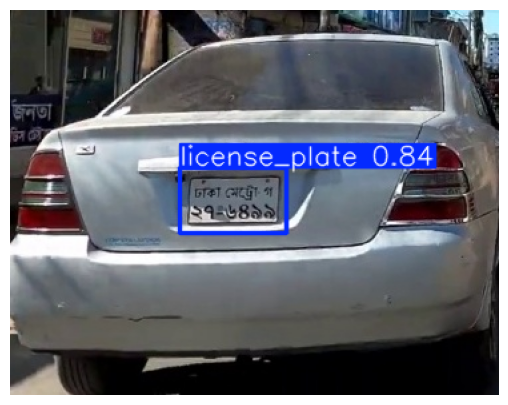

Plate cropped and saved at /content/plate.jpg


In [ ]:
from ultralytics import YOLO
import cv2
import numpy as np
import matplotlib.pyplot as plt  # Ensure plt is imported

# Load trained YOLOv8 model
model = YOLO("/content/license_plate_detector.pt")

# Read image
image_path = "/content/crop (1).jpg"
image = cv2.imread(image_path)

# Run inference
results = model(image)  # This returns a list of Results objects

# Ensure results are not empty
if results:
    result = results[0]  # Get the first result

    # Convert image to RGB (since OpenCV loads images in BGR)
    rendered_image = result.plot()  # This correctly renders the image with bounding boxes

    # Show the image
    plt.figure(figsize=(10, 5))
    plt.imshow(cv2.cvtColor(rendered_image, cv2.COLOR_BGR2RGB))
    plt.axis("off")
    plt.show()

    # Extract bounding boxes
    for box in result.boxes.xyxy:  # Get bounding box (x1, y1, x2, y2)
        x1, y1, x2, y2 = map(int, box)
        plate_img = image[y1:y2, x1:x2]  # Crop detected plate

        # Save cropped image
        cv2.imwrite("/content/plate.jpg", plate_img)

        print(f"Plate cropped and saved at /content/plate.jpg")
else:
    print("No detections found.")


In [ ]:
!pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 39.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 32.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 969.6/969.6 kB 59.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.6/286.6 kB 24.4 MB/s eta 0:00:00


In [ ]:
import easyocr

# Initialize EasyOCR reader
reader = easyocr.Reader(['bn'])  # Use 'bn' for Bangla

# Read text from the cropped number plate
result = reader.readtext("/content/plate.jpg")

# Print recognized text
plate_number = " ".join([res[1] for res in result])  # Extract detected text
print("Detected Number Plate:", plate_number)


Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% CompleteDetected Number Plate: মেদ্দ্রী ২৭-৬8৯
